Explanation about this notebook is given in the blogpost https://www.smalsresearch.be/autocorrelation-spatiale--qui-se-rassemble-se-ressemble (in French)

Installations on a fresh Conda environment (with jupyter or jupyterlab installed):

- conda install seaborn
- conda install geopandas libpysal esda
- conda install openpyxl xlrd

Inspiration: 
- https://github.com/geopandas/scipy2018-geospatial-data/blob/master/06-exploratory-spatial-data-analysis.ipynb
- https://github.com/pysal/scipy2019-intermediate-gds/blob/master/notebooks/gds5-exploration.ipynb    

In [1]:
import os
import urllib

import geopandas as gpd# to read/write spatial data
import pandas as pd# to read/write plain tables
import numpy as np
import shapely

import libpysal as lp
import esda 
from sklearn.metrics import r2_score

import matplotlib.pyplot as plt # to visualize data
import matplotlib.transforms as transforms
from matplotlib import colors

import seaborn as sbn

datapath = "data/autocorrel"
outputpath="output/autocorrel"

In [2]:
# from IPython.core.display import display, HTML
# display(HTML("<style>.container { width:100% !important; }</style>"))

In [3]:
def download_if_nexist(url, filename):
    """
    If the (local) file <filename> does not exists, download it from <url> 

    Parameters
    ----------
    url: str
       url to fetch
    filename: str
       local file to save

    Returns
    -------

    None
    """
    if not os.path.isfile(filename):
        with urllib.request.urlopen(url) as response:
            with open(filename, "wb") as f:
                f.write(response.read())

In [4]:
%matplotlib inline

# Data load

In [5]:
os.makedirs(datapath,   exist_ok=True)
os.makedirs(outputpath, exist_ok=True)

## Statistical sectors

We first load the geographical definitions of statistical sectors, from StatBel. By aggregating the on "CNIS5_2020" (NIS code of a commune), we obtain commune boundaries

In [6]:
download_if_nexist("https://statbel.fgov.be/sites/default/files/files/opendata/Statistische%20sectoren/sh_statbel_statistical_sectors_31370_20200101.shp.zip",
                   f"{datapath}/stat_sectors_2020.zip")

statistical_sectors = gpd.read_file(f"zip://{datapath}/stat_sectors_2020.zip/sh_statbel_statistical_sectors_20200101.shp")
statistical_sectors["CNIS5_2020"] = statistical_sectors["CNIS5_2020"].astype(str)
# statistical_sectors = statistical_sectors.to_crs(osm_crs)
statistical_sectors.columns= statistical_sectors.columns.str.lower()
# statistical_sectors

In [7]:
# Get commune boundaries from statistical sector boundaries
sectors = statistical_sectors[["cnis5_2020", "geometry", "t_mun_fr"]].dissolve("cnis5_2020")
sectors = sectors.reset_index().rename({"cnis5_2020": "code", "t_mun_fr": "name"}, axis=1)
sectors.head()

,code,geometry,name
0,11001,"POLYGON Z ((150146.614 200004.830 0.000, 15004...",Aartselaar
1,11002,"POLYGON Z ((150427.738 203934.363 0.000, 15042...",Anvers
2,11004,"POLYGON Z ((160710.892 204171.221 0.000, 16070...",Boechout
3,11005,"POLYGON Z ((151375.980 197079.947 0.000, 15137...",Boom
4,11007,"POLYGON Z ((159339.112 209024.062 0.000, 15932...",Borsbeek


In [8]:
# Get province bounds (for visualisation purpose only)
extra_bounds = statistical_sectors[["t_provi_fr", "geometry"]].dissolve("t_provi_fr")
extra_bounds

,geometry
t_provi_fr,
Province de Flandre occidentale,"POLYGON Z ((83489.530 159995.491 0.000, 83488...."
Province de Flandre orientale,"POLYGON Z ((98736.032 158867.058 0.000, 98719...."
Province de Liège,"POLYGON Z ((276506.515 96694.991 0.000, 276514..."
Province de Namur,"POLYGON Z ((193240.987 54915.334 0.000, 193226..."
Province du Brabant flamand,"POLYGON Z ((126516.330 154035.693 0.000, 12651..."
Province du Brabant wallon,"POLYGON Z ((150959.609 139257.480 0.000, 15088..."
Province du Hainaut,"MULTIPOLYGON Z (((154103.564 70323.214 0.000, ..."
Province du Limbourg,"MULTIPOLYGON Z (((205615.858 154477.589 0.000,..."
Province du Luxembourg,"POLYGON Z ((234354.943 23041.209 0.000, 234310..."


<AxesSubplot:>

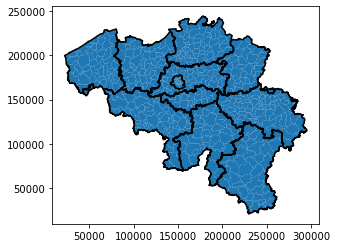

In [9]:
ax = sectors.plot()
extra_bounds.boundary.plot(ax=ax, color='k')

## Values

### Area

In [10]:
area = sectors[["code", "geometry"]]#.area

area["area"] = area.area/10**6
area = area[["code", "area"]]

### Cars per households

In [11]:
download_if_nexist("https://statbel.fgov.be/sites/default/files/files/opendata/Aantal%20wagens%20per%20statistische%20sector/TF_CAR_HH_SECTOR.xlsx",
                   f"{datapath}/TF_CAR_HH_SECTOR.xlsx")

In [15]:
car_per_hh = pd.read_excel(f"{datapath}/TF_CAR_HH_SECTOR.xlsx")
car_per_hh = car_per_hh.rename(columns = {"total_huisH": "MS_NUM_HH", "total_wagens": "MS_NUM_CAR"})
car_per_hh = car_per_hh.groupby("CD_REFNIS")[["MS_NUM_HH", "MS_NUM_CAR"]].sum().reset_index()
car_per_hh["car_per_hh"] = car_per_hh.MS_NUM_CAR / car_per_hh.MS_NUM_HH
car_per_hh = car_per_hh[["CD_REFNIS", "car_per_hh"]].rename(columns={"CD_REFNIS": "code"})
car_per_hh["code"] = car_per_hh["code"].astype(str)


/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/openpyxl/worksheet/header_footer.py:48: UserWarning: Cannot parse header or footer so it will be ignored
  warn("""Cannot parse header or footer so it will be ignored""")


In [18]:
# car_per_hh

### Income


In [19]:
download_if_nexist("https://statbel.fgov.be/sites/default/files/files/documents/Huishoudens/10.9%20Fiscale%20inkomens/fisc2018_C_FR.xls",
                   f"{datapath}/fisc_income.xls")

In [20]:
income = pd.read_excel(f"{datapath}/fisc_income.xls", sheet_name="par décl. indiv.", skiprows=6)
income = income.rename(columns={"Unnamed: 1":"code", 
                                "Revenu médian par déclaration": "median_income",
                                "Revenu moyen par déclaration": "mean_income"})
income = income[["code", "median_income", "mean_income"]]
income = income[income.code.notnull()]
income["code"] = income["code"].astype(int).astype(str)
# income

### Census

In [21]:
# Data from https://www.census2011.be/
download_if_nexist("https://visuals.statbel.fgov.be/visuals/data/census.csv", 
                   f"{datapath}/census.csv")

In [22]:
census= pd.read_csv(f"{datapath}/census.csv", sep=";",  decimal=",")
census = census.rename(columns={"Geography": "code", 
                                "Older than 20 with high degree": "with_degree",
                                "Number of habitants": "population"})

census["code"] = census["code"].astype(str)

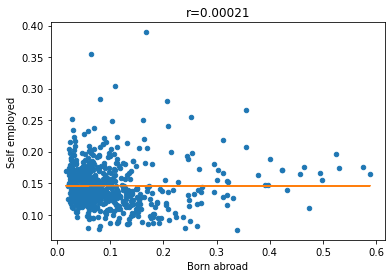

In [23]:
#c1="Unemployed"
#c2="Married"

c1="Born abroad"
c2="Self employed"
pearson_r = np.corrcoef(census[c1], census[c2])[0][1]

# Plot dots
census.plot.scatter(x=c1, y=c2, title=f"r={pearson_r:.2}")

# Plot regression line
m, b = np.polyfit(census[c1].fillna(0), census[c2].fillna(0), 1)
plt.plot(census[c1].fillna(0), m*census[c1].fillna(0) + b, color="C1")
plt.savefig(f'{outputpath}/correlation.png', dpi=150,  bbox_inches='tight')


In [24]:
census_fields = ["with_degree", "population"]
census = census[["code"] + census_fields]

In [25]:
%matplotlib inline

In [26]:
# Census is older then the last commune fusions. Need some adjustments 
code_changes= {
    "55022": "58001",
    "56011": "58002",
    "56085": "58003",
    "56087": "58004",
    "52063": "55085",
    "52043": "55086",
    "55010": "51067",
    "55039": "51068",
    "55023": "51069",
    "54007": "57096",
    "54010": "57097"
}

In [27]:
code_fusions = {
    "72042": ["72040", "71047"],       # Meeuwen-Gruitrode et Opglabbeek: Code INS 72042 (nouveau nom : Oudsbergen)
    "72043": ["72025", "72029"],       # Neerpelt et Overpelt: Code INS 72043 (nouveau nom : Pelt)
    "45068": ["45017", "45057"],       # Kruishoutem et Zingem: Code INS 45068 (nouveau nom : Kruisem)
    "44084": ["44029", "44001"],       # Aalter et Knesselare: Code INS 44084 (nouveau nom : Aalter)
    "44083": ["44049", "44011"],       # Deinze et Nevele: Code INS 44083 (nouveau nom : Deinze)
    "12041": ["12030", "12034"],       # Puurs et Sint-Amands: Code INS 12041 (nouveau nom : Puurs-Sint-Amands)
    "44085": ["44072", "44036", "44080"]  # Waarschoot, Lovendegem & Zomergem: Code INS 44085 (nouveau nom : Lievegem)
}

In [28]:
for new_code in code_fusions:
    new_rec = census[census.code.isin(code_fusions[new_code])][census_fields].mean()
    new_rec["code"] = new_code
    census = census[~census.code.isin(code_fusions[new_code])]
    
    census = census.append(new_rec, ignore_index=True)
    

/tmp/ipykernel_24236/3969332177.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  census = census.append(new_rec, ignore_index=True)
/tmp/ipykernel_24236/3969332177.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  census = census.append(new_rec, ignore_index=True)
/tmp/ipykernel_24236/3969332177.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  census = census.append(new_rec, ignore_index=True)
/tmp/ipykernel_24236/3969332177.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  census = census.append(new_rec, ignore_index=True)
/tmp/ipykernel_24236/3969332177.py:6: FutureWarning: The frame.append method is deprecated and will be r

In [29]:
census["code"] = census.code.replace(code_changes)

In [30]:
with_degree=census[["code", "with_degree"]]
population=census[["code", "population"]]

### Random

In [31]:
random1 = sectors[["code"]].copy()
random1["random1"] = np.random.randint(1, 1000, random1.shape[0])/1000


In [32]:
random2 = sectors[["code"]].copy()
random2["random2"] = np.random.randint(1, 1000, random2.shape[0])/1000


### Merge

In [33]:
data = (sectors
        .merge(car_per_hh)
        .merge(area)
        .merge(random1)
        .merge(random2)
        .merge(with_degree, how="left")
        .merge(population, how="left")
        .merge(income, how="left"))

data["density"] = data["population"] / data["area"]
# data_columns = ["accid_per_km2", "car_per_hh", "area", "random1", "random2", "with_degree", "median_income"]
data_columns = ["car_per_hh", "area", "random1", "random2", "with_degree", "population", "density", "median_income", "mean_income"]
#data_columns = ["random1", "random2", "accid_per_km2"]


data.head()

,code,geometry,name,car_per_hh,area,random1,random2,with_degree,population,median_income,mean_income,density
0,11001,"POLYGON Z ((150146.614 200004.830 0.000, 15004...",Aartselaar,1.325331,11.019132,0.016,0.248,0.3474,14335.0,21966.0,25191.0,1300.919195
1,11002,"POLYGON Z ((150427.738 203934.363 0.000, 15042...",Anvers,0.735126,204.319831,0.548,0.786,0.2564,498473.0,18417.0,21707.0,2439.670190
2,11004,"POLYGON Z ((160710.892 204171.221 0.000, 16070...",Boechout,1.246273,20.708315,0.758,0.154,0.3782,12764.0,20091.0,23442.0,616.370759
3,11005,"POLYGON Z ((151375.980 197079.947 0.000, 15137...",Boom,1.047522,7.382118,0.145,0.475,0.2092,17042.0,19088.0,21716.0,2308.551554
4,11007,"POLYGON Z ((159339.112 209024.062 0.000, 15932...",Borsbeek,1.022247,3.901369,0.580,0.787,0.2483,10235.0,20257.0,22653.0,2623.438105


# Bivariate (classical) correlations 

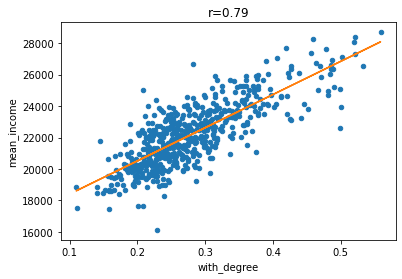

In [34]:
c1= "with_degree"
c2= "mean_income"

# c1= "area"
# c2= "population"

# Compute pearson coeficient
pearson_r = np.corrcoef(data[c1], data[c2])[0][1]

# Plot dots
data.plot.scatter(x=c1, y=c2, title=f"r={pearson_r:.2}")

# Plot regression line
m, b = np.polyfit(data[c1].fillna(0), data[c2].fillna(0), 1)
plt.plot(data[c1].fillna(0), m*data[c1].fillna(0) + b, color="C1")
plt.savefig(f'{outputpath}/correlation.png', dpi=150,  bbox_inches='tight')


# Plot raw data

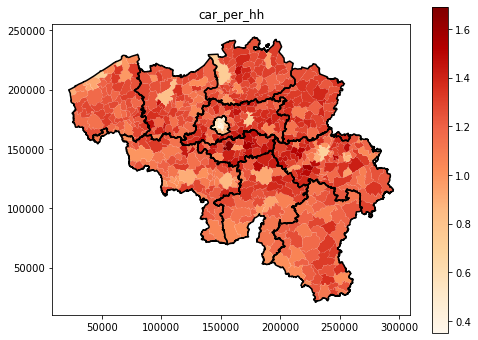

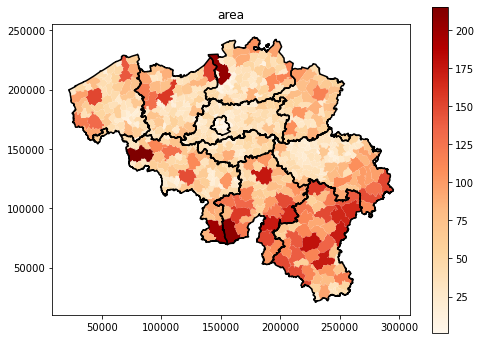

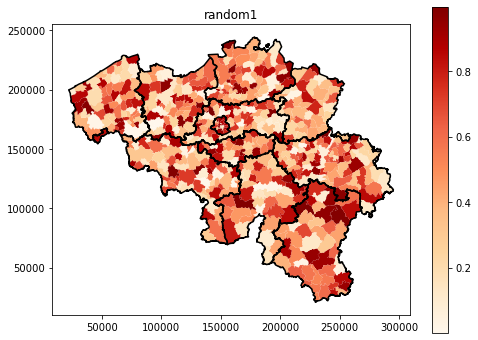

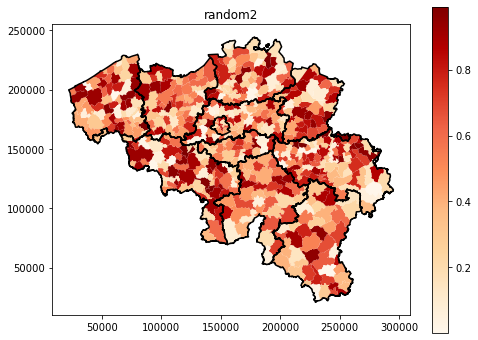

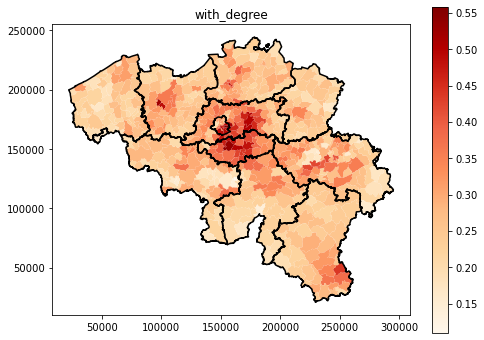

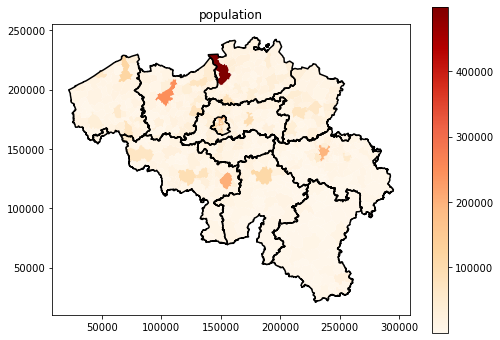

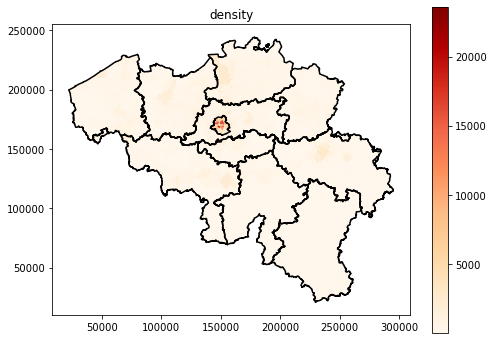

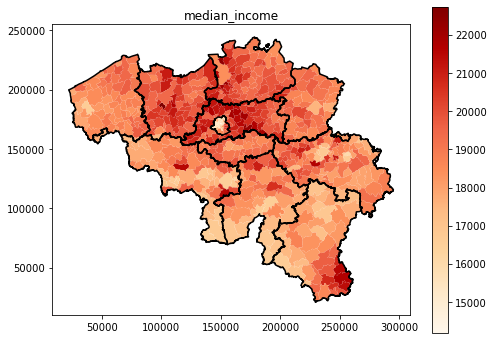

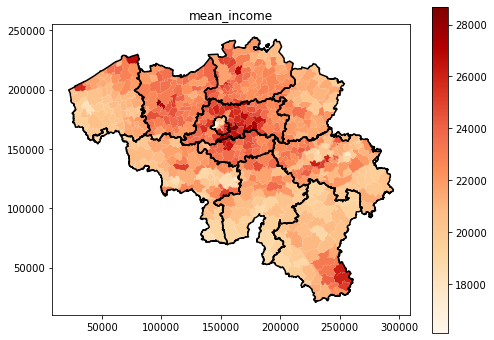

In [35]:
for v in data_columns:
    ax = data.plot(v, missing_kwds=dict(color='grey', label='No Data'), legend=True, figsize=(8,6), cmap="OrRd")
    extra_bounds.boundary.plot(ax=ax, color='k')
    ax.set_title(v)

## Using quantile classification

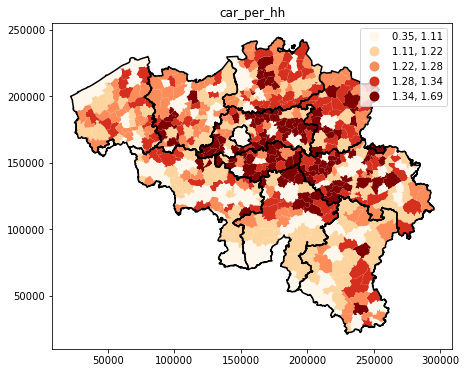

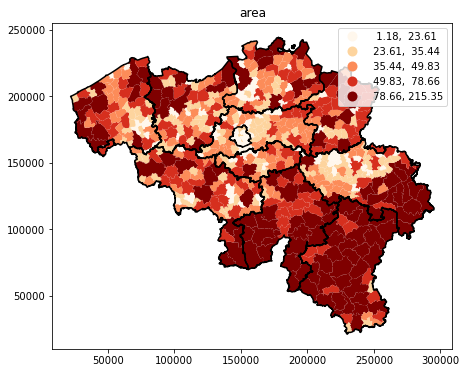

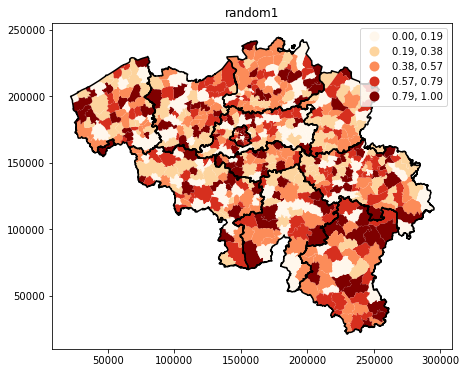

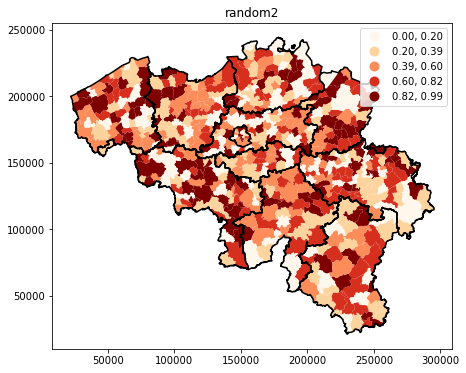

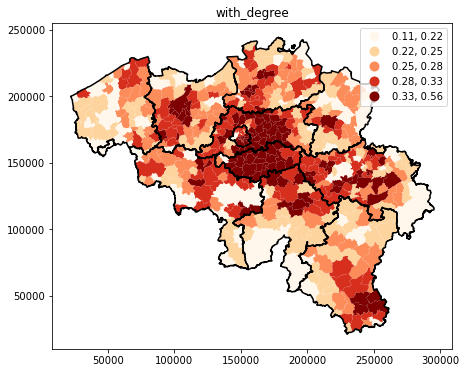

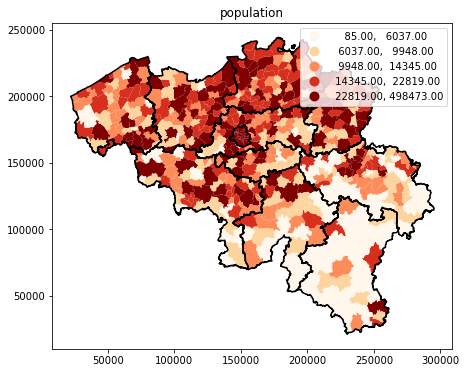

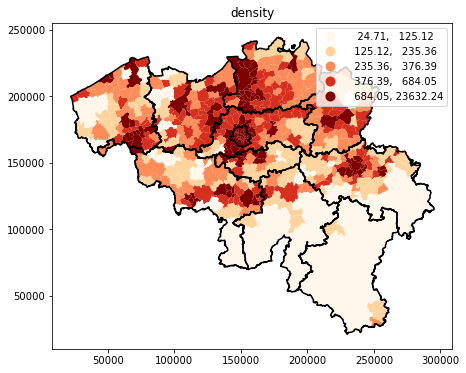

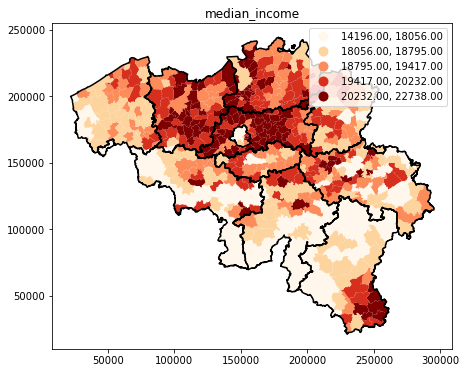

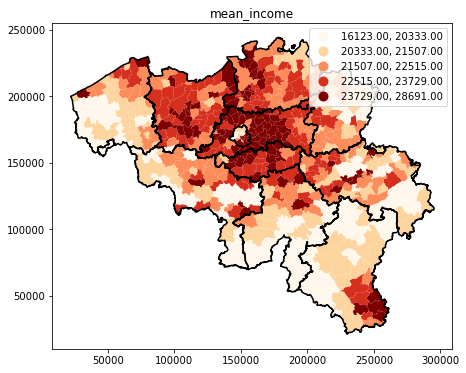

In [36]:
for v in data_columns:
    ax = data.plot(v, legend=True, figsize=(8,6), cmap="OrRd", scheme="quantiles", k=5)
    extra_bounds.boundary.plot(ax=ax, color='k')
    ax.set_title(v)


# Queen neighborhood

Computing spatial autocorrelation requires which sector is close to each each other. Boudaries data we process so far just define commune boundaries as polygons, but do not directly indicates which commune "touches" (even by one single point) which other commune. 

This can be done by the computation of the "Queen neighborhood". Note that this requires good quality polygons. If they overlaps, or have small gaps, queen neighborhood won't work correctly.

In [37]:
wq =  lp.weights.Queen.from_dataframe(data)
wq.transform = 'r'


/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))


In [38]:
# Tells which records is neighbor to which other record

{k:wq.neighbors[k] for k in range(5)}

{0: [16, 1, 18, 19, 7, 9, 13],
 1: [0, 4, 5, 7, 297, 298, 9, 12, 15, 21, 22, 23, 24, 28],
 2: [17, 35, 4, 24, 10, 14, 15],
 3: [16, 41, 18, 40],
 4: [24, 1, 2, 15]}

<AxesSubplot:>

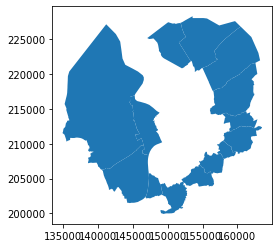

In [39]:
data.loc[wq.neighbors[1]].plot()

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

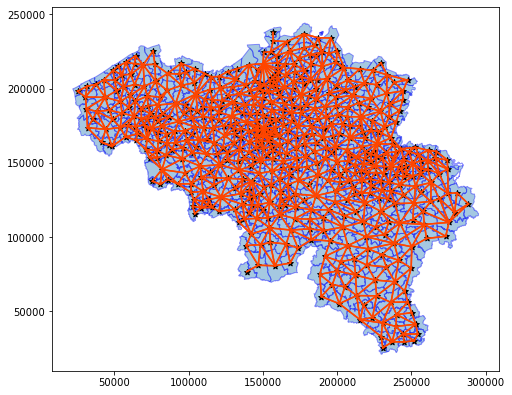

In [40]:
f = plt.figure(figsize=(8,8))
ax = plt.gca()
# when you only want to plot the boundaries:
data.plot( ax=ax, alpha=.4, edgecolor="b")
wq.plot(data, edge_kws=dict(linewidth=1.5, color='orangered'), 
              node_kws=dict(marker='*'), ax=ax)
plt.show()

# Spatial lag

The spatial lag for a sector is average value of all the touching sectors


In [41]:
ylag = {v: lp.weights.lag_spatial(wq, data[v]) for v in data_columns}

In [42]:
# ylag

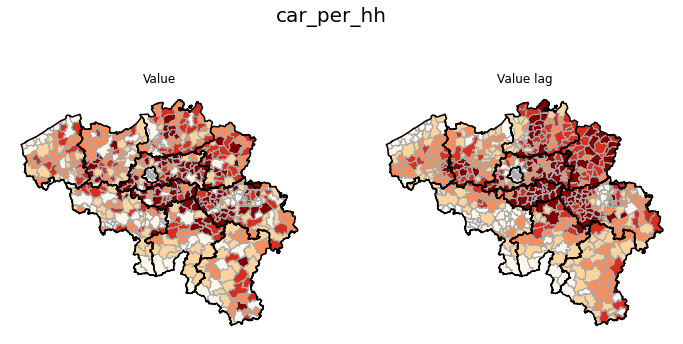

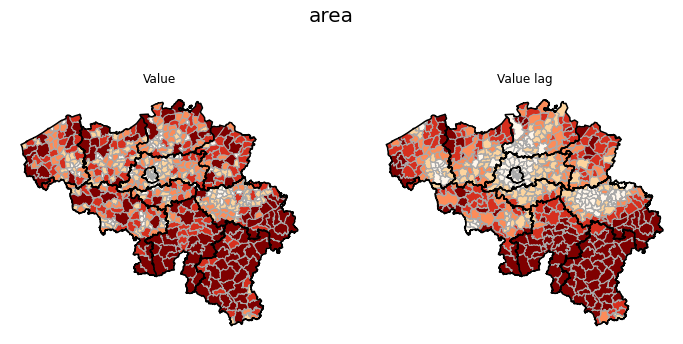

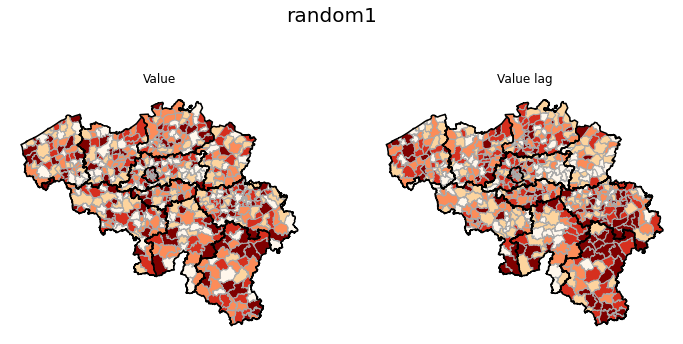

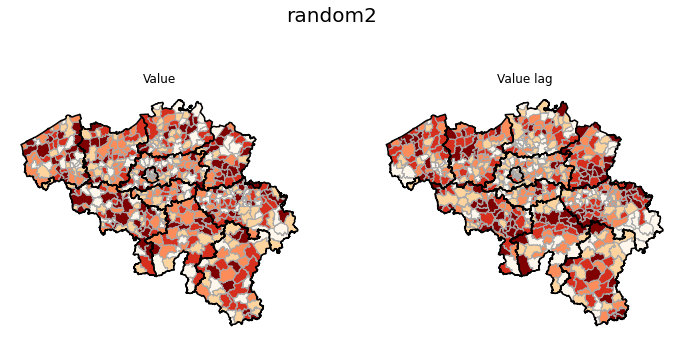

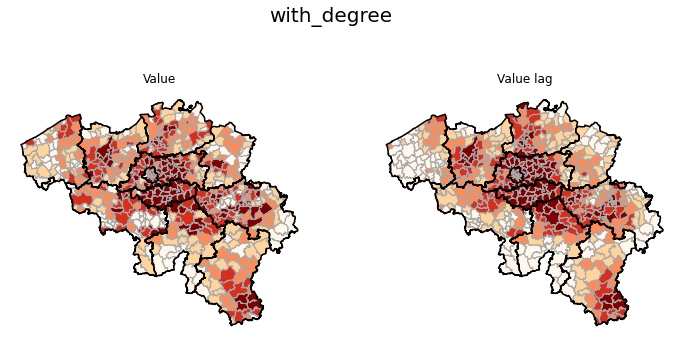

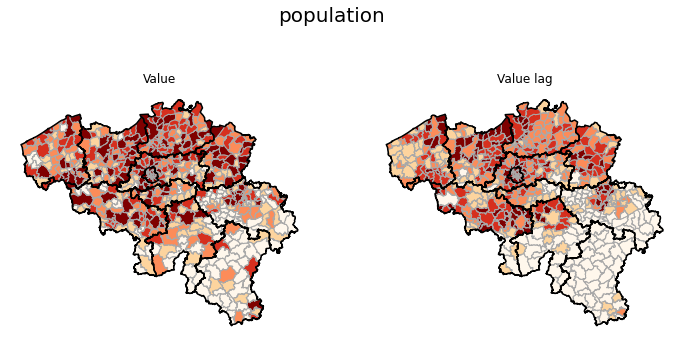

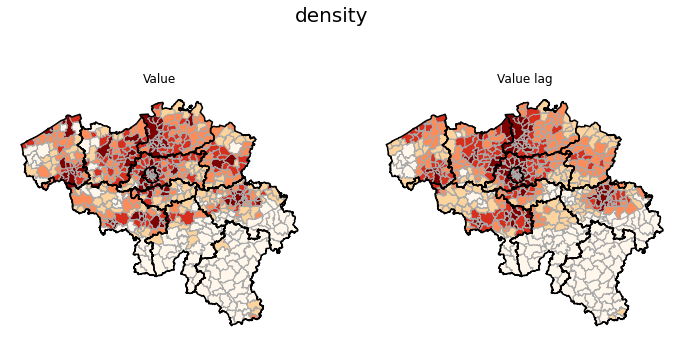

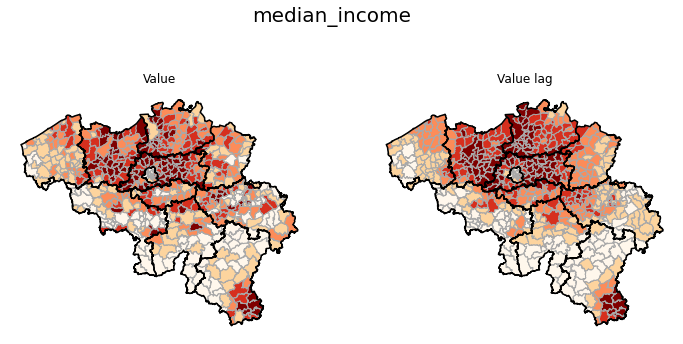

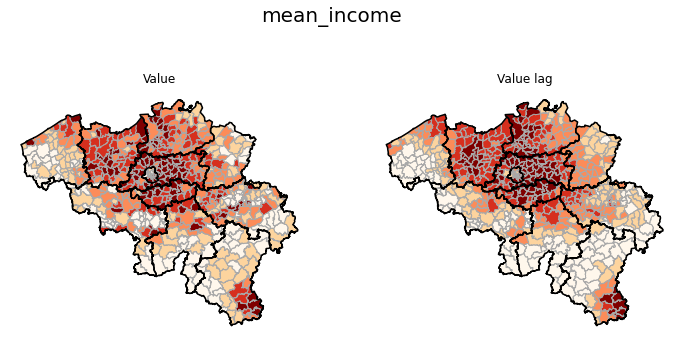

In [43]:
for v in data_columns:
    #f,ax = plt.subplots(1,2,figsize=(20,10))
    f,ax = plt.subplots(1,2,figsize=(12,6)) # Small figs to spare github disk space...
    
    f.suptitle(v, fontsize=20)
    data.plot(v, ax=ax[0], scheme='quantiles',  cmap='OrRd', edgecolor="darkgrey")
    extra_bounds.boundary.plot(ax=ax[0], color='k')
    ax[0].set_title("Value")
    ax[0].axis('off')

    data.assign(lag=ylag[v]).plot("lag", ax=ax[1], scheme='quantiles',  cmap='OrRd', edgecolor="darkgrey")
    extra_bounds.boundary.plot(ax=ax[1], color='k')
    ax[1].set_title("Value lag")
    ax[1].axis('off')

    plt.show()

## Moran's scatterplot

Moran's scatterplot plots for each sector its value on one axis, and its spatial lag on the other axis. It allows to see the correlation between a sector and neighborhood.


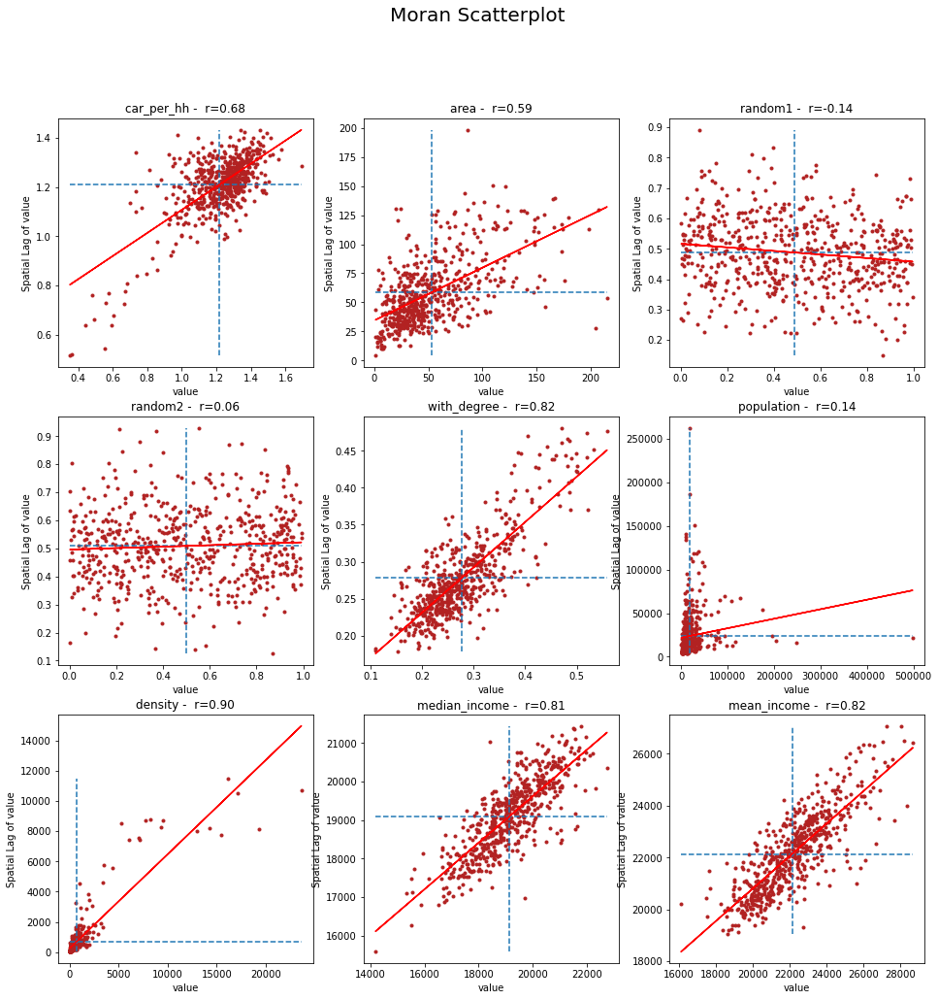

In [44]:
d_col = data_columns# ["random1", "mean_income"]
# d_col = ["random2", "area", "mean_income"]
f, ax = plt.subplots(int(np.ceil(len(d_col)/3)), 3, 
#                      figsize=(16, 8), 
                     figsize=(16, 16), 
                     squeeze=True
                    )
f.suptitle("Moran Scatterplot", fontsize=20)
ax = ax.flatten()
for i, v in enumerate(d_col):
    
    b, a = np.polyfit(data[v], ylag[v], 1)
   
    pearson_r = np.corrcoef(data[v], ylag[v])[0][1]


    ax[i].plot(data[v], ylag[v], '.', color='firebrick')

    # dashed vert at mean of the value
    ax[i].vlines(data[v].mean(), ylag[v].min(), ylag[v].max(), linestyle='--')

    # dashed horizontal at mean of lagged value 
    ax[i].hlines(ylag[v].mean(), data[v].min(), data[v].max(), linestyle='--')

    # red line of best fit using global I as slope
    ax[i].plot(data[v], a + b*data[v], 'r')
    ax[i].set_title(f'{v} -  r={pearson_r:.2f}')
    ax[i].set_ylabel('Spatial Lag of value')
    ax[i].set_xlabel('value')

for i in range(i+1, len(ax)):
    ax[i].set_axis_off()
    
plt.savefig(f'{outputpath}/spatial_lag_mora_scatterplot.png', dpi=150,  bbox_inches='tight')

# Global spatial autocorrelation

With the global spatial autocorrelation, we'll caracterize the autocorrelation of a metric with on single value, which basicaly tells how this variable behaves regarding a fully random metric attribution.

We'll first present a simplified vue, where the continuous range of value is converted to a binary value. We then generalize by a fully continuous variable 

## Binary

Each value is converted to "0" (Low, of White) if below the median, 1 (High, Black) otherwise. Works well if the median cuts the dataset into to roughly even parts, but not if there are many identical values

In [45]:
yb = {v: data[v] > data[v].median() for v in data_columns}
#yb

In [46]:
for v in data_columns:
    labels = ["0 Low", "1 High"]

    data[v+'_yb'] = [labels[i] for i in 1*yb[v]] 
# data

In [47]:
# yb

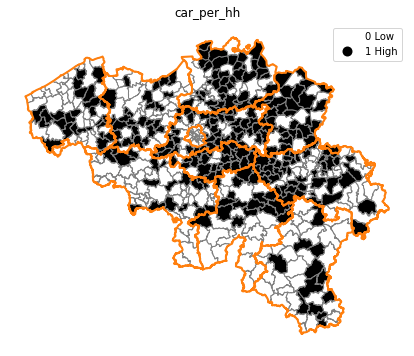

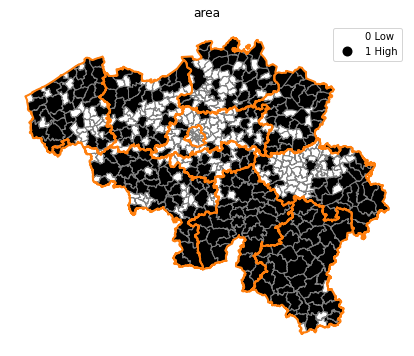

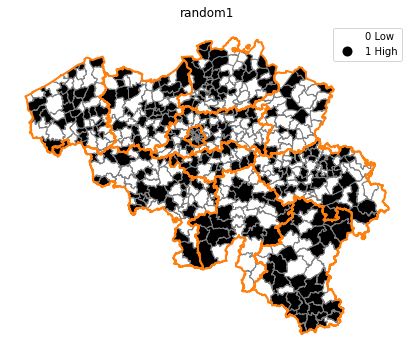

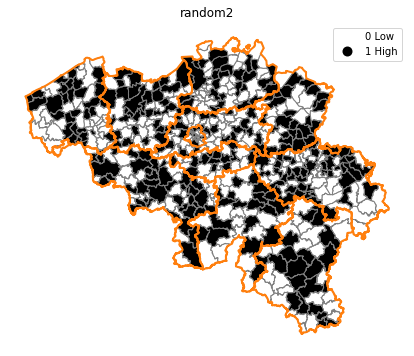

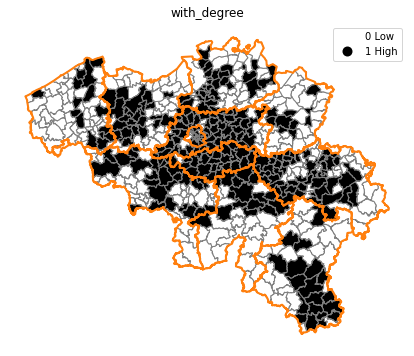

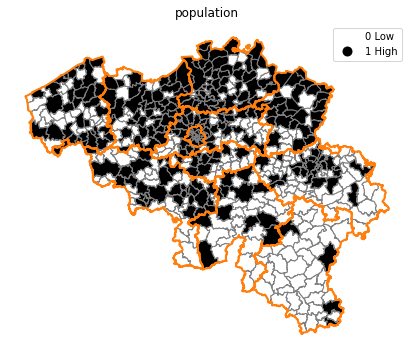

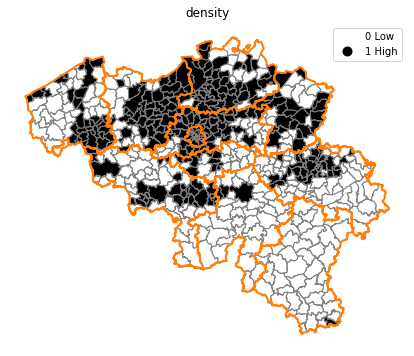

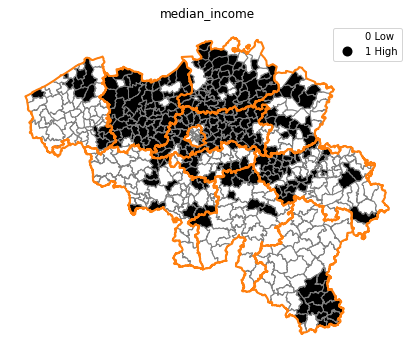

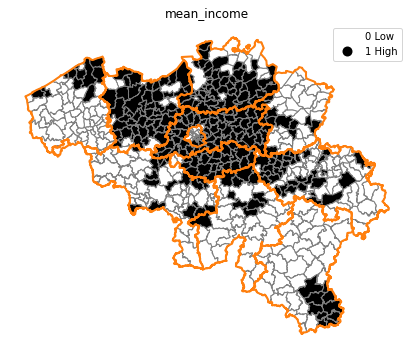

In [48]:
for v in data_columns:
    #fig = plt.figure(figsize=(12,10))
    fig = plt.figure(figsize=(8,6))
    ax = plt.gca()
    data.plot(column=v+'_yb', cmap='binary', edgecolor='grey', legend=True, ax=ax)
    #ax.set_facecolor('lightgrey')
    plt.axis("off")
    extra_bounds.boundary.plot(ax=ax, color='C1', linewidth=2)
    ax.set_title(v)

## Join cuts

The "Join_Counts" methods counts =
- bb: how many "black-black" joins we have (black sector touching another black sector)
- mean_bb: how many "black-black" joins we would have if the value was random
- sim_bb: many (default: 999) "black-black joins counts" obtained on random tests

In [49]:
wq =  lp.weights.Queen.from_dataframe(data)
wq.transform = 'b'
np.random.seed(12345)

jc = {}
yb = {}
for v in data_columns:
    yb[v] = 1 * (data[v] > data[v].median()) # convert back to binary
    # print(yb[v].value_counts())
    jc[v] = esda.join_counts.Join_Counts(yb[v], wq)
    print(f"{v:20}: BB counts: {jc[v].bb} - Average BB count: {jc[v].mean_bb}")

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))


car_per_hh          : BB counts: 470.0 - Average BB count: 408.07507507507506
area                : BB counts: 580.0 - Average BB count: 408.78678678678676
random1             : BB counts: 397.0 - Average BB count: 409.6256256256256
random2             : BB counts: 429.0 - Average BB count: 407.955955955956
with_degree         : BB counts: 601.0 - Average BB count: 408.94794794794797
population          : BB counts: 560.0 - Average BB count: 408.6226226226226
density             : BB counts: 626.0 - Average BB count: 408.8658658658659
median_income       : BB counts: 619.0 - Average BB count: 408.44844844844846
mean_income         : BB counts: 646.0 - Average BB count: 408.2832832832833


### Random BB count animation

In [50]:
def plot_bb(data, v, ax):
    data_black = data[data[v]>data[v].median()].reset_index()
    
    wq_bb =  lp.weights.Queen.from_dataframe(data_black)
    
    # when you only want to plot the boundaries:
    # data.plot( ax=ax, alpha=.4, edgecolor="b")
    ax=data.plot(column=v+'_yb', cmap='binary', edgecolor='grey', legend=True, ax=ax)
    extra_bounds.boundary.plot(ax=ax, color='C1', linewidth=2)


    wq_bb.plot(data_black, edge_kws=dict(linewidth=2, color='C6'), 
              node_kws=dict(marker='*'), ax=ax)

    #plt.show()
    return wq_bb.to_adjlist().shape[0]/2
# plot_bb(data, "random1", ax=None)

In [52]:
# !mkdir output/autocorrel/joincuts/

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 29 disconnected components.
 There are 13 islands with ids: 5, 15, 132, 134, 145, 148, 150, 173, 174, 194,

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


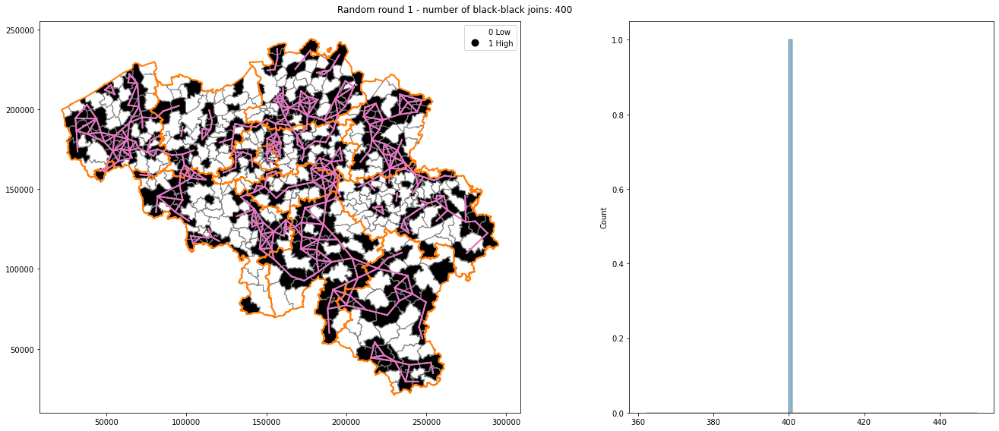

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 25 disconnected components.
 There are 11 islands with ids: 35, 57, 68, 91, 109, 110, 146, 160, 162, 176, 

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

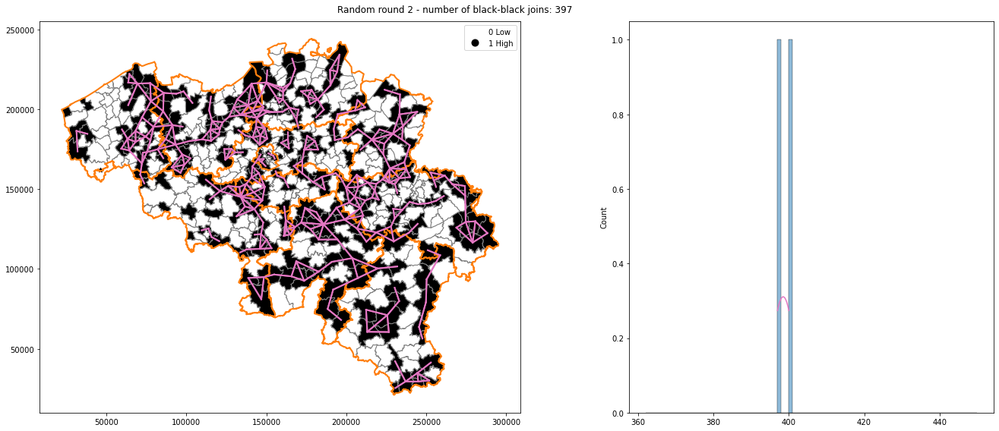

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 23 disconnected components.
 There are 13 islands with ids: 66, 88, 94, 106, 107, 108, 118, 122, 142, 170,

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


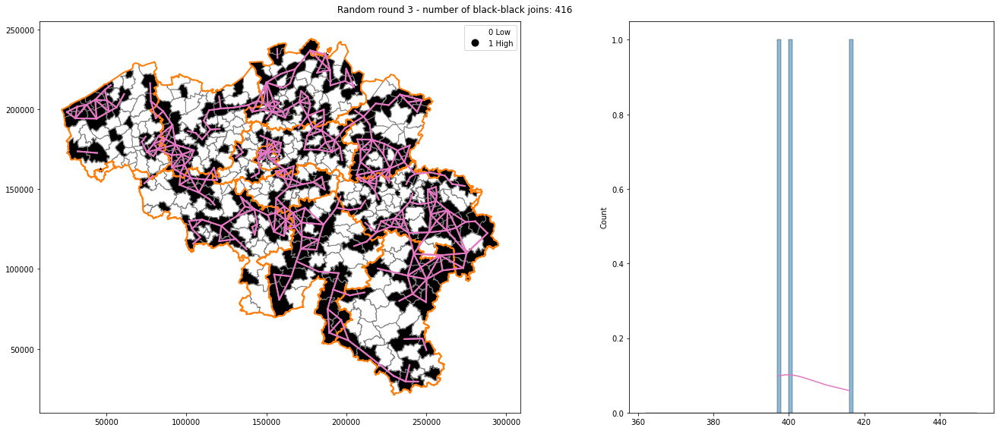

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 23 disconnected components.
 There are 9 islands with ids: 102, 116, 205, 211, 219, 234, 249, 252, 255.
  

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


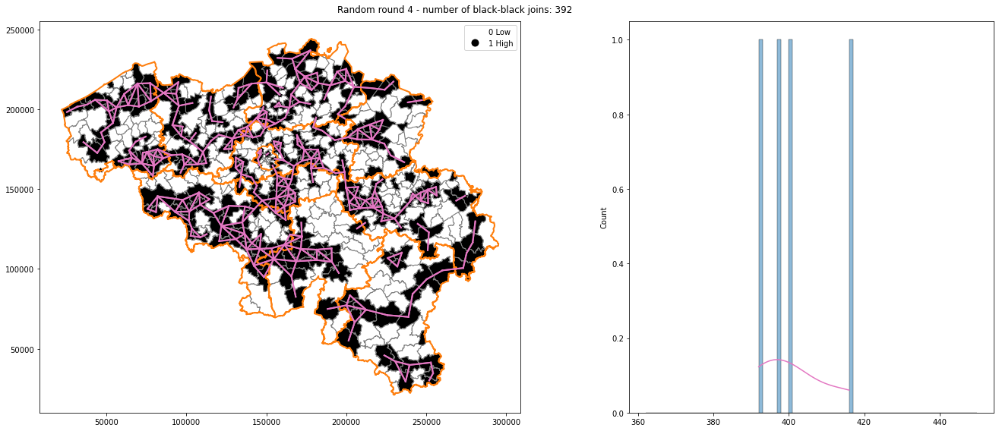

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 30 disconnected components.
 There are 16 islands with ids: 26, 29, 43, 45, 65, 76, 108, 114, 122, 144, 17

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


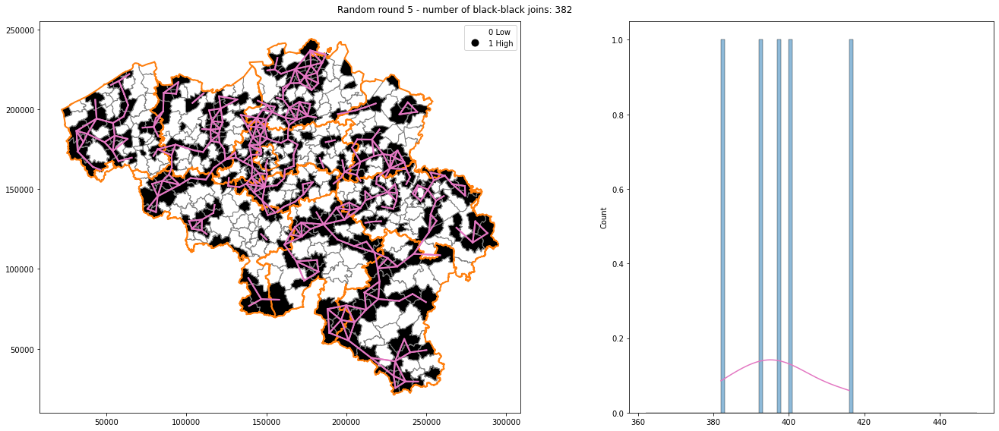

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 24 disconnected components.
 There are 12 islands with ids: 43, 143, 151, 205, 218, 240, 241, 243, 244, 25

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

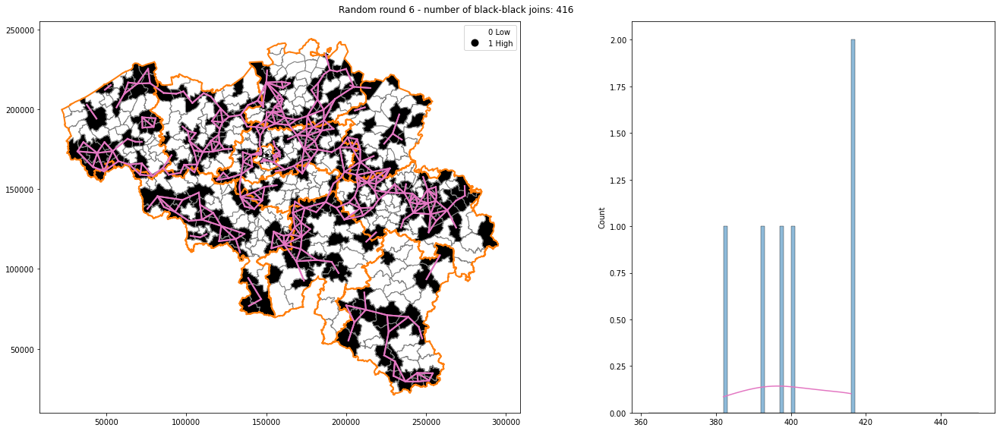

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 32 disconnected components.
 There are 16 islands with ids: 5, 46, 104, 107, 123, 138, 139, 140, 155, 182,

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


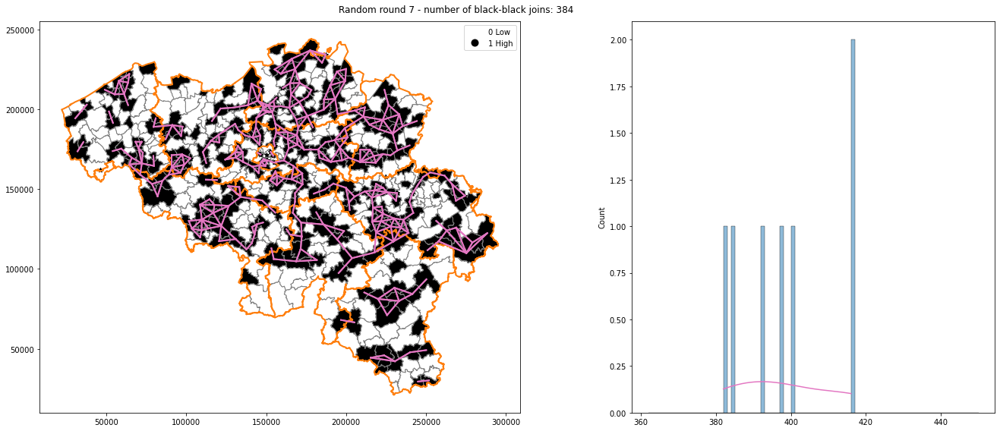

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 25 disconnected components.
 There are 8 islands with ids: 0, 3, 9, 65, 117, 123, 139, 260.
  warnings.war

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


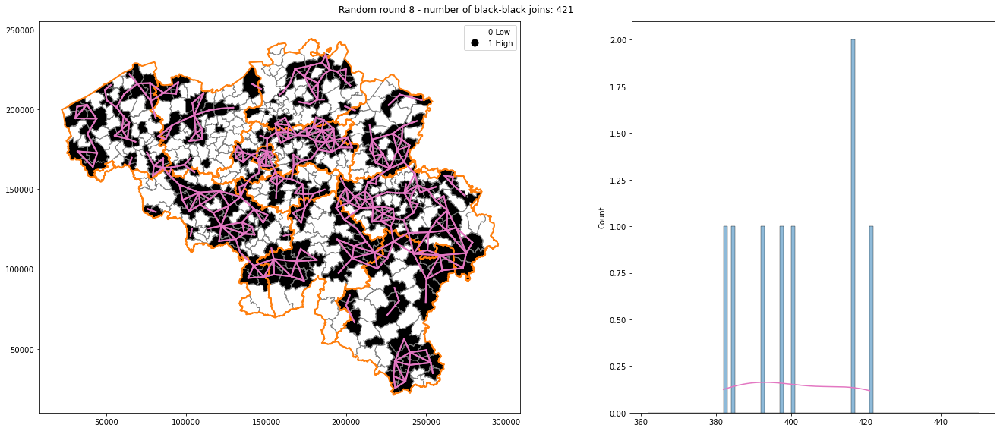

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 20 disconnected components.
 There are 7 islands with ids: 0, 7, 86, 162, 183, 250, 255.
  warnings.warn(m

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


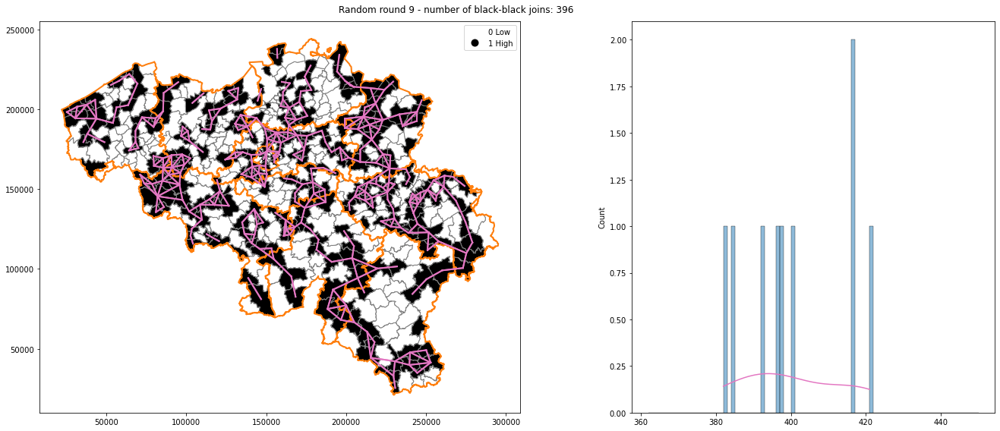

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 23 disconnected components.
 There are 10 islands with ids: 22, 27, 129, 130, 132, 161, 208, 217, 273, 276

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


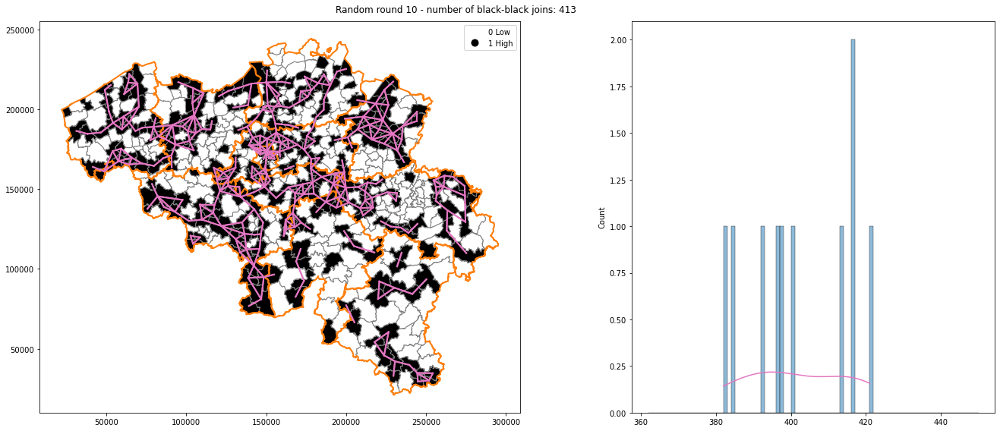

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 30 disconnected components.
 There are 15 islands with ids: 10, 41, 49, 98, 108, 123, 144, 164, 229, 249, 

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


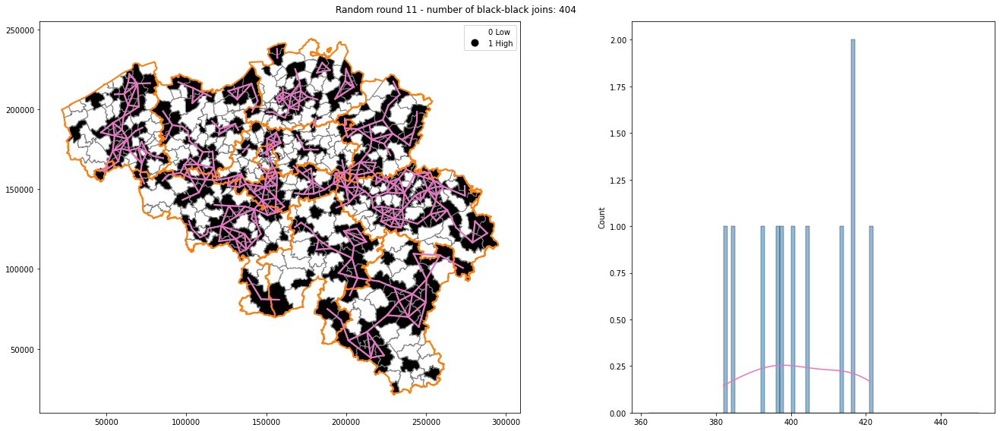

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 30 disconnected components.
 There are 17 islands with ids: 20, 57, 85, 93, 108, 110, 111, 155, 171, 177, 180, 204, 205, 245, 254, 273, 276.
  warnings.warn(message)
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an ind

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


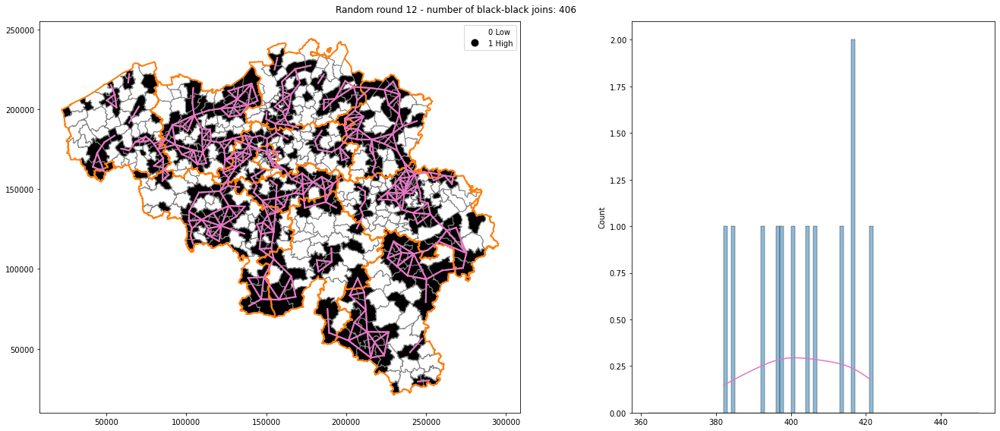

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 26 disconnected components.
 There are 10 islands with ids: 82, 98, 140, 153, 173, 217, 246, 265, 272, 274

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


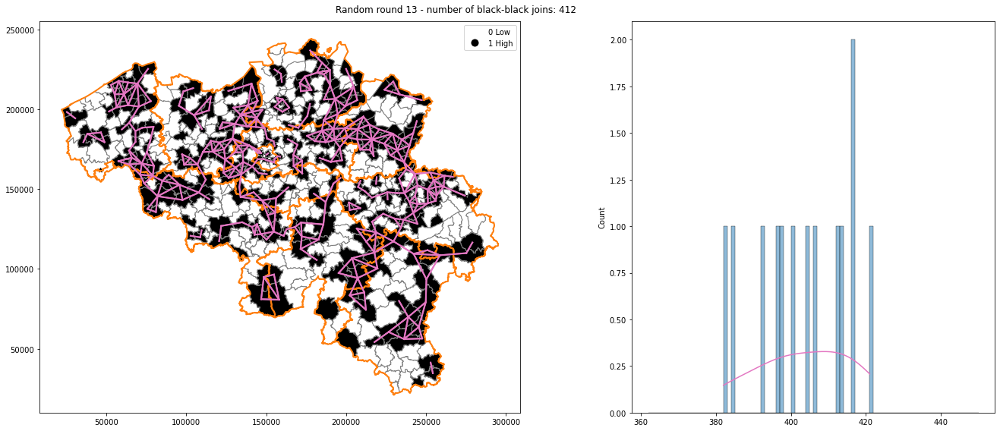

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 22 disconnected components.
 There are 9 islands with ids: 65, 86, 90, 138, 187, 258, 259, 269, 285.
  war

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


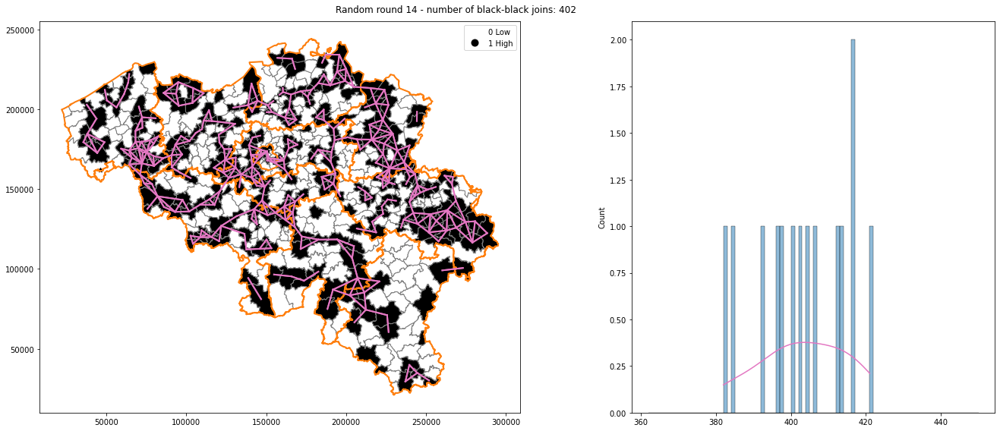

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 28 disconnected components.
 There are 11 islands with ids: 28, 95, 96, 136, 176, 199, 251, 258, 259, 275,

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


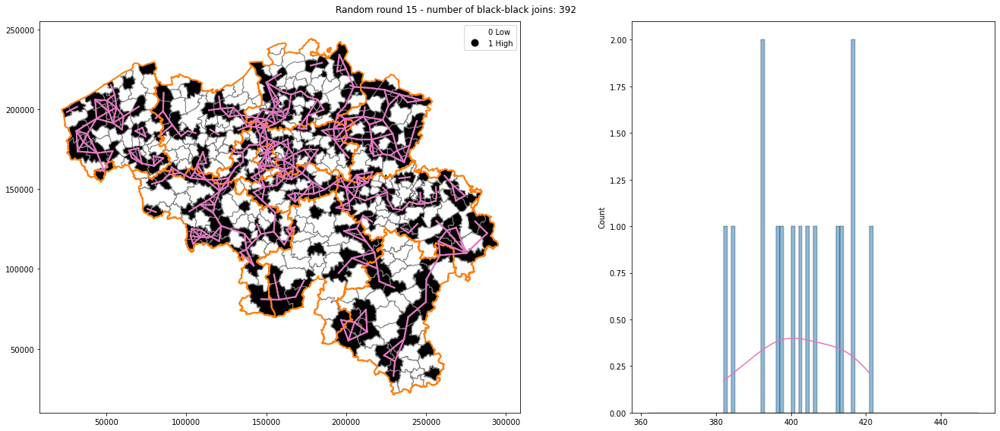

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 24 disconnected components.
 There are 9 islands with ids: 44, 45, 123, 176, 185, 191, 192, 196, 201.
  wa

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


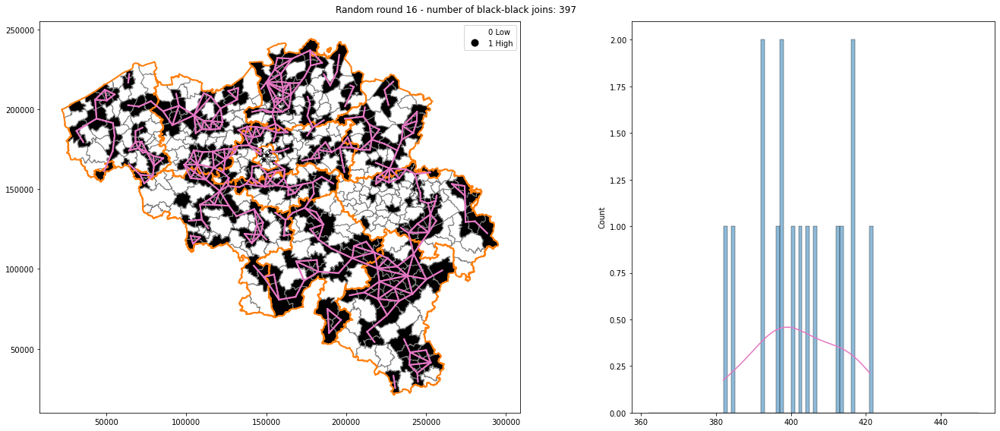

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 18 disconnected components.
 There are 10 islands with ids: 4, 29, 106, 107, 133, 180, 182, 222, 247, 265.

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


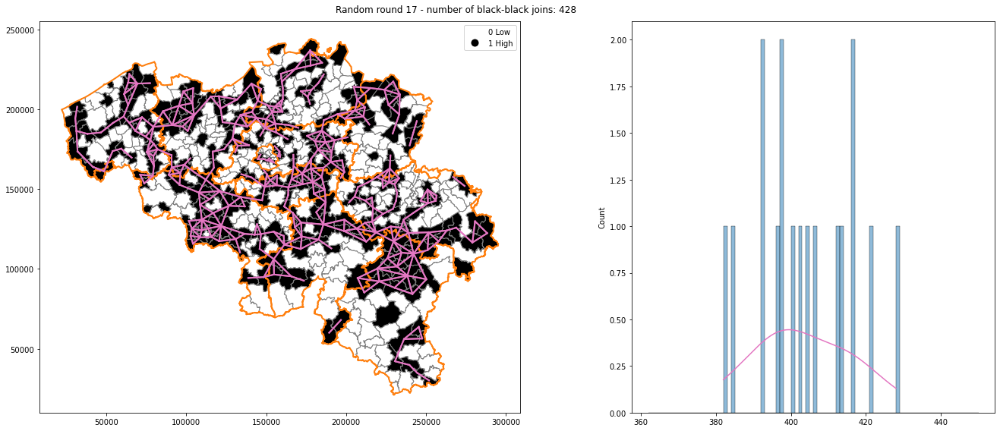

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 26 disconnected components.
 There are 12 islands with ids: 14, 67, 70, 79, 101, 121, 124, 193, 273, 277, 

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


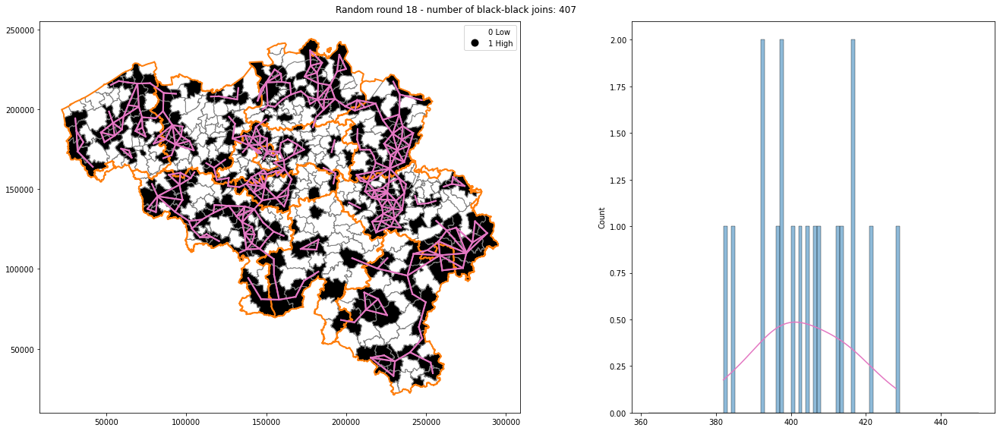

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 28 disconnected components.
 There are 13 islands with ids: 4, 11, 27, 68, 99, 102, 130, 153, 160, 161, 16

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

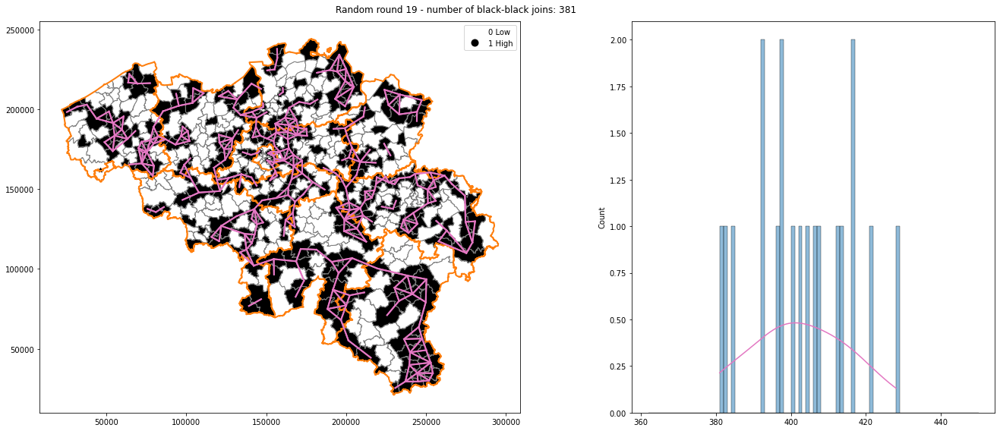

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 27 disconnected components.
 There are 11 islands with ids: 21, 100, 165, 180, 181, 186, 194, 202, 236, 26

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

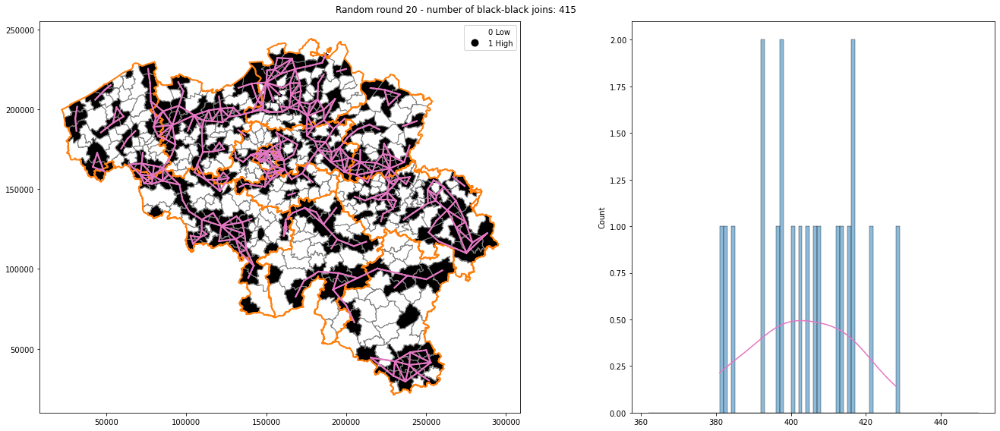

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 25 disconnected components.
 There are 12 islands with ids: 1, 3, 33, 75, 86, 114, 115, 163, 200, 203, 219

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


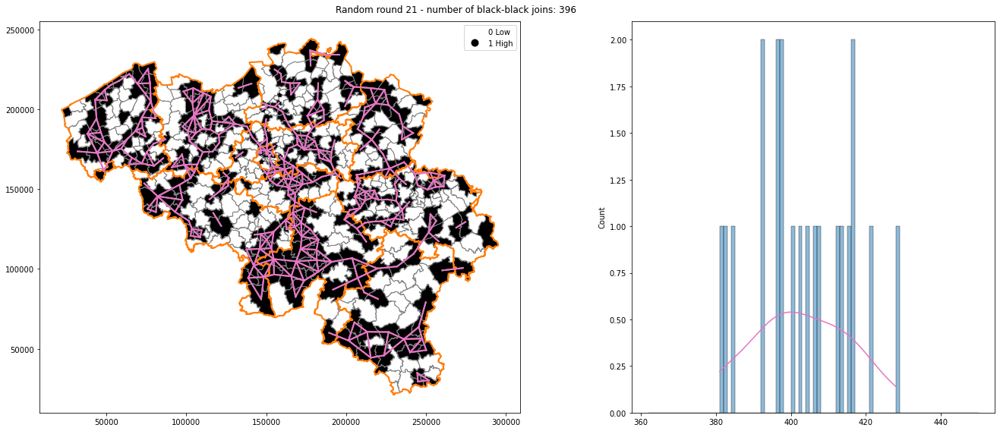

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 22 disconnected components.
 There are 6 islands with ids: 154, 175, 214, 215, 218, 265.
  warnings.warn(m

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


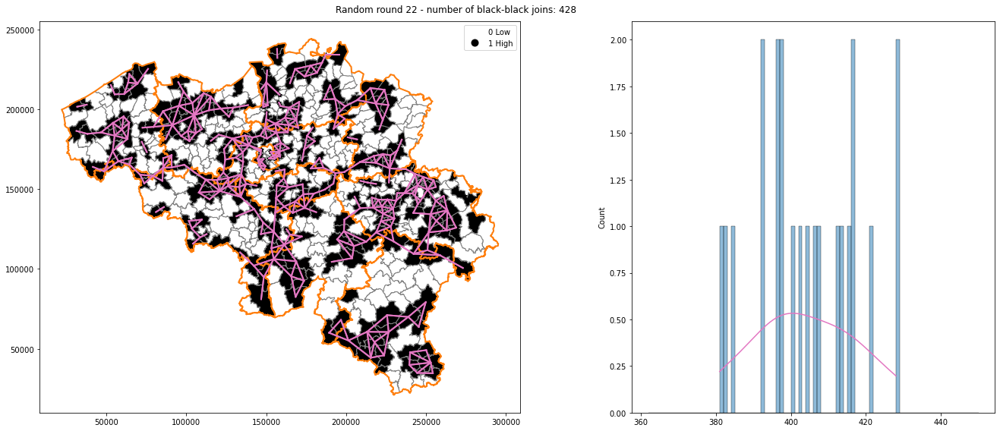

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 20 disconnected components.
 There are 12 islands with ids: 23, 88, 133, 176, 179, 193, 214, 215, 221, 249

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


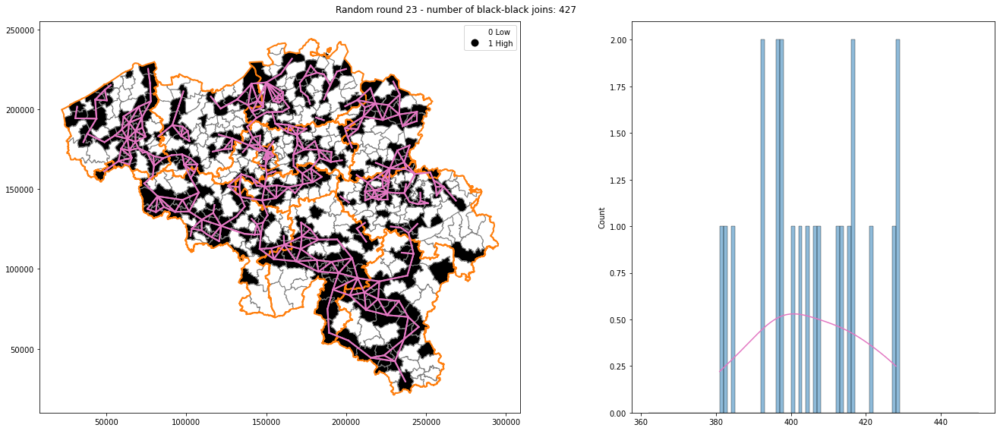

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 22 disconnected components.
 There are 9 islands with ids: 80, 89, 98, 119, 178, 185, 191, 212, 249.
  war

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


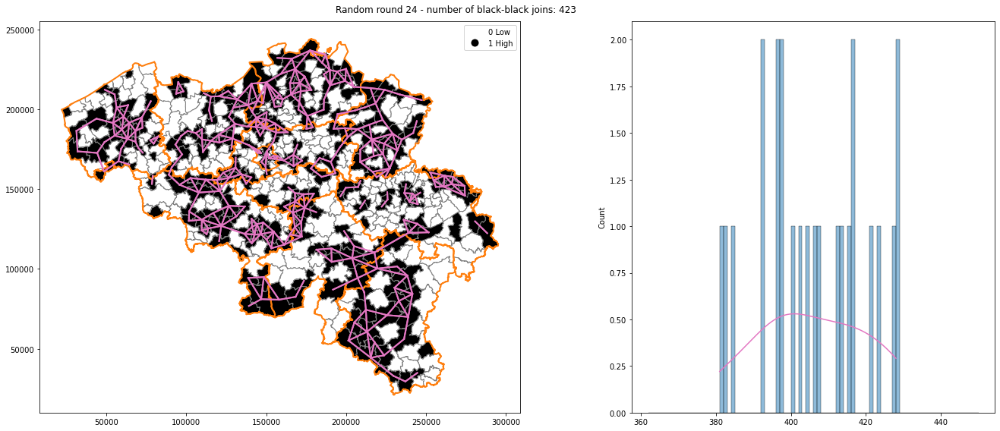

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 30 disconnected components.
 There are 16 islands with ids: 0, 25, 26, 27, 29, 33, 38, 47, 94, 96, 104, 16

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


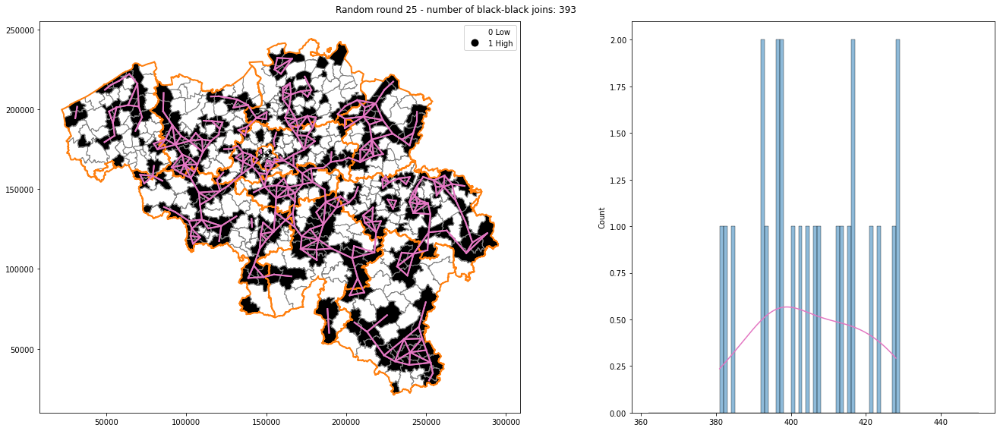

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 18 disconnected components.
 There are 7 islands with ids: 4, 112, 151, 177, 190, 221, 236.
  warnings.war

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


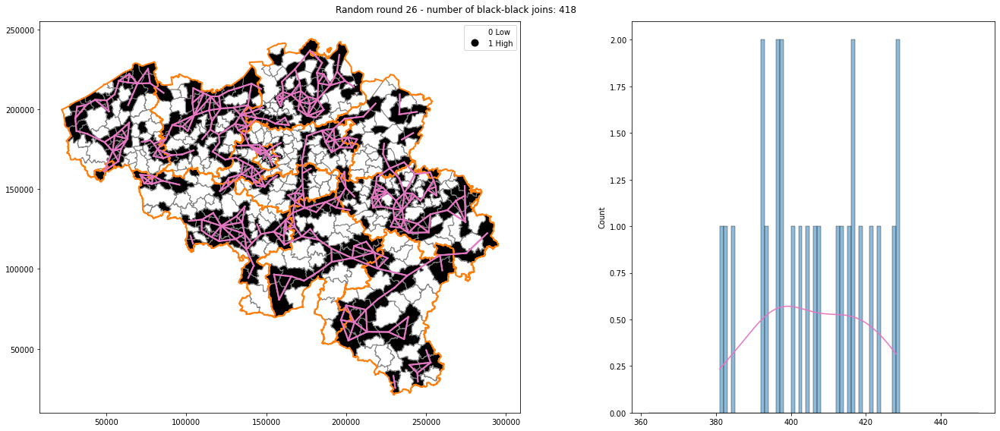

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 27 disconnected components.
 There are 10 islands with ids: 3, 39, 50, 58, 74, 160, 238, 239, 267, 274.
  

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


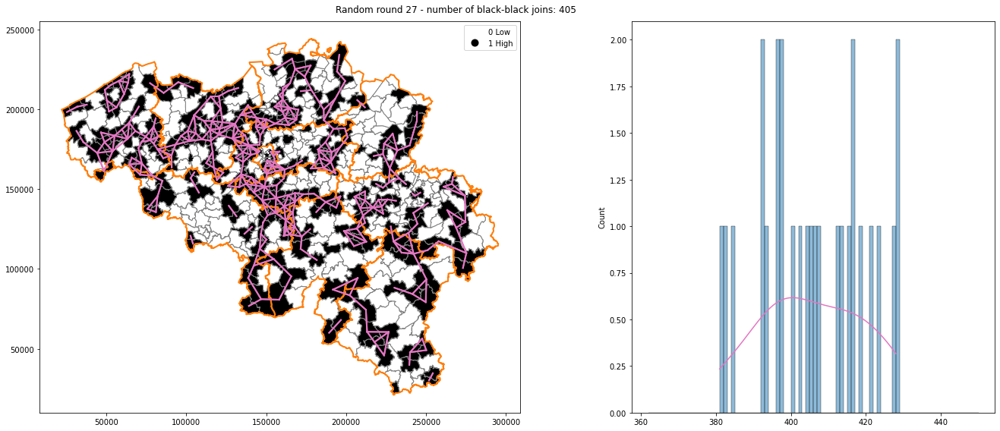

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 22 disconnected components.
 There are 13 islands with ids: 10, 82, 114, 125, 148, 153, 167, 180, 235, 243

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


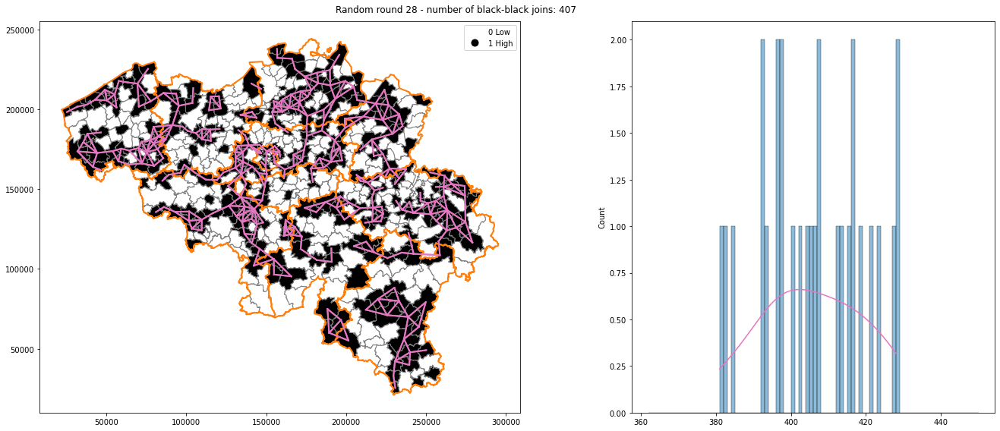

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 21 disconnected components.
 There are 8 islands with ids: 1, 13, 17, 52, 234, 236, 270, 277.
  warnings.warn(message)
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weigh

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


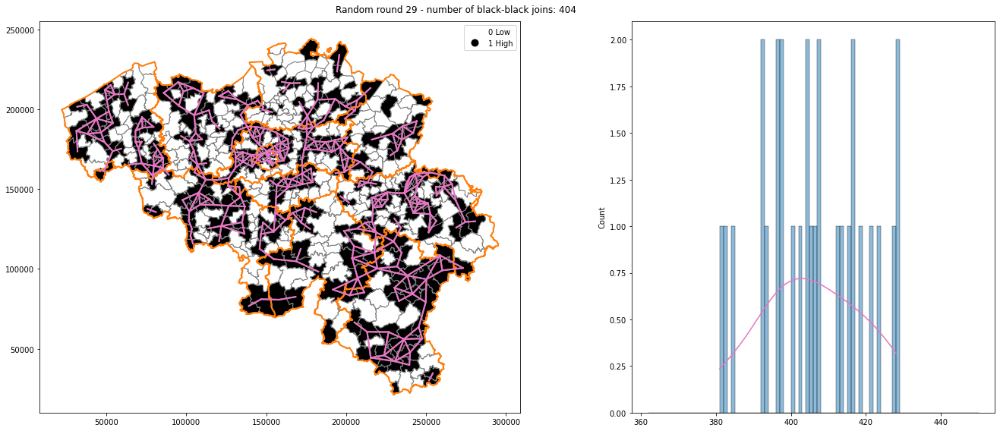

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 26 disconnected components.
 There are 13 islands with ids: 62, 101, 165, 169, 174, 192, 196, 235, 238, 24

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


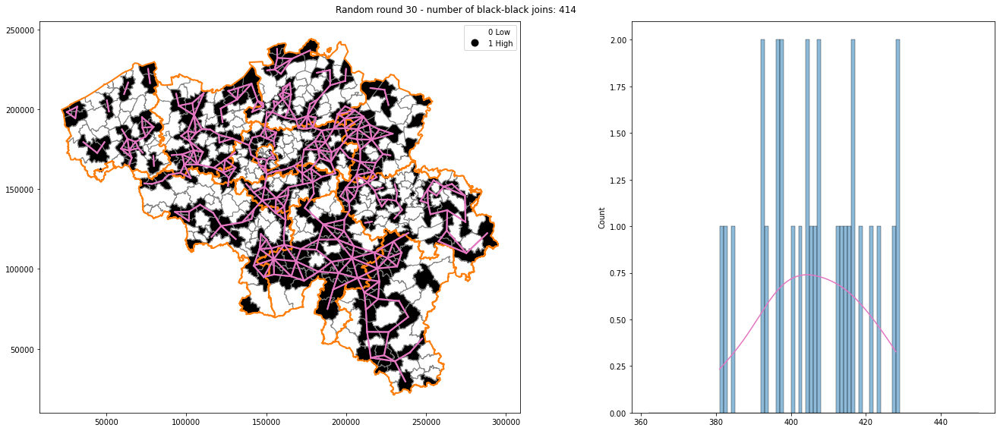

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 30 disconnected components.
 There are 19 islands with ids: 4, 15, 41, 55, 113, 137, 144, 166, 169, 172, 1

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


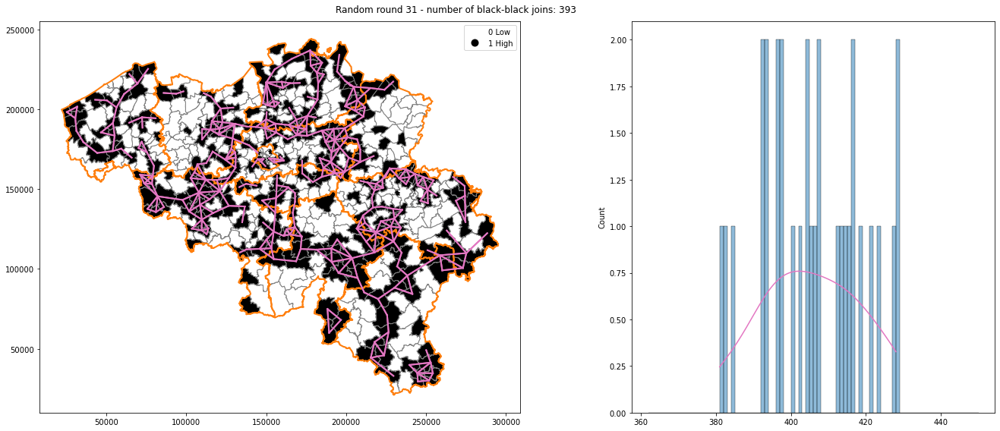

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 35 disconnected components.
 There are 14 islands with ids: 1, 3, 7, 9, 18, 33, 34, 84, 126, 128, 139, 245

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


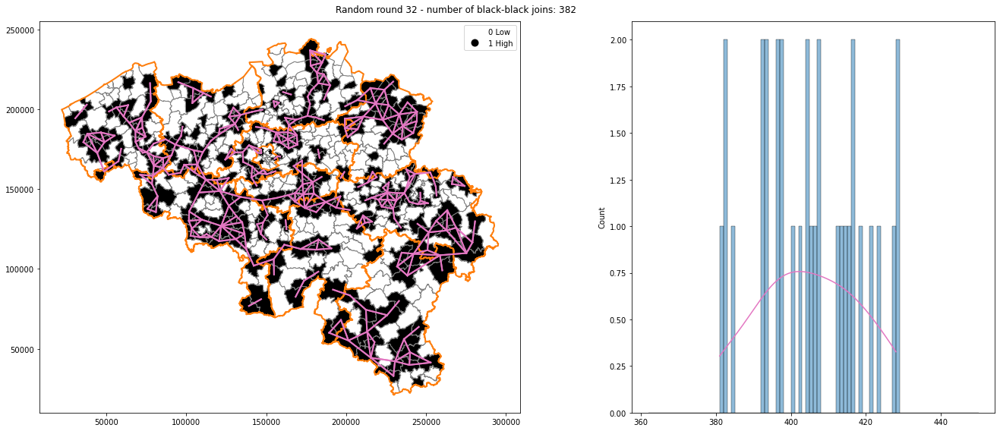

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 23 disconnected components.
 There are 9 islands with ids: 47, 117, 127, 179, 240, 245, 246, 260, 277.
  w

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


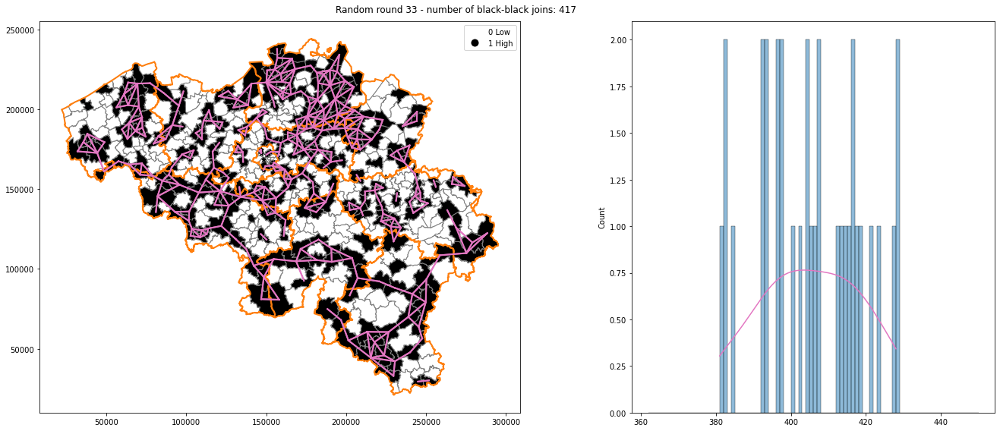

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 19 disconnected components.
 There are 6 islands with ids: 7, 103, 181, 198, 229, 271.
  warnings.warn(mes

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


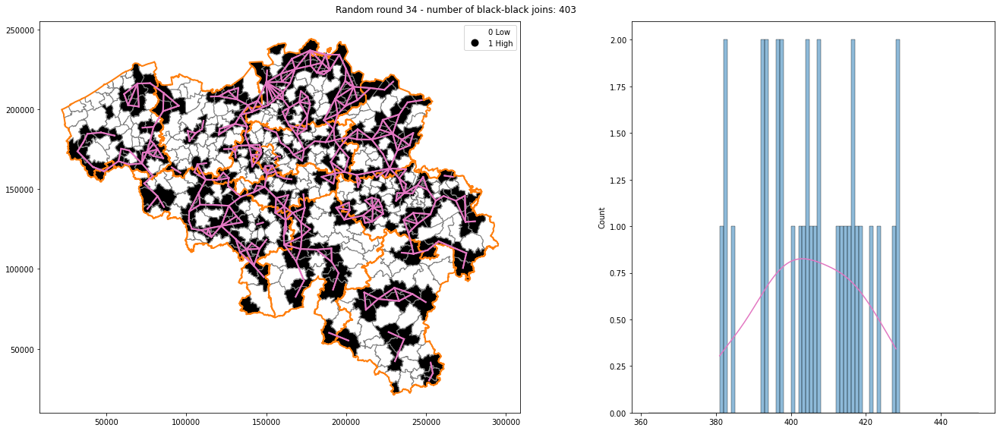

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 15 disconnected components.
 There are 7 islands with ids: 25, 85, 100, 109, 177, 218, 233.
  warnings.war

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


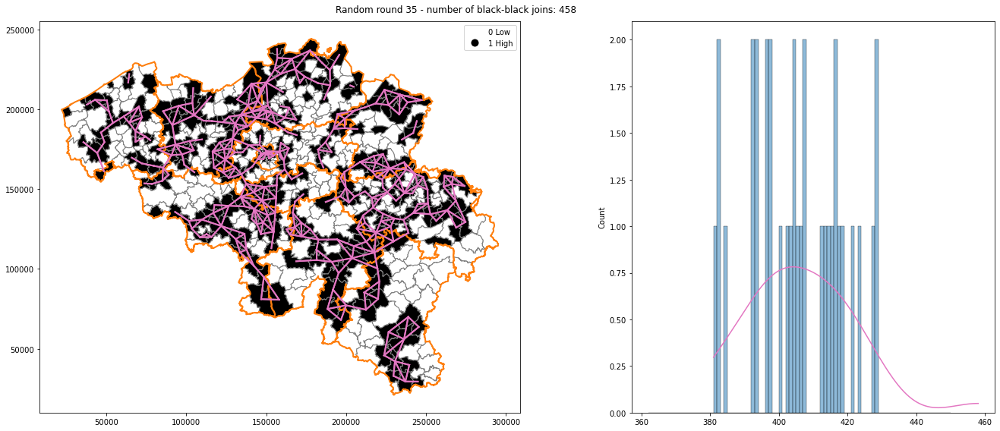

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 22 disconnected components.
 There are 9 islands with ids: 42, 118, 121, 136, 215, 218, 222, 276, 278.
  w

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


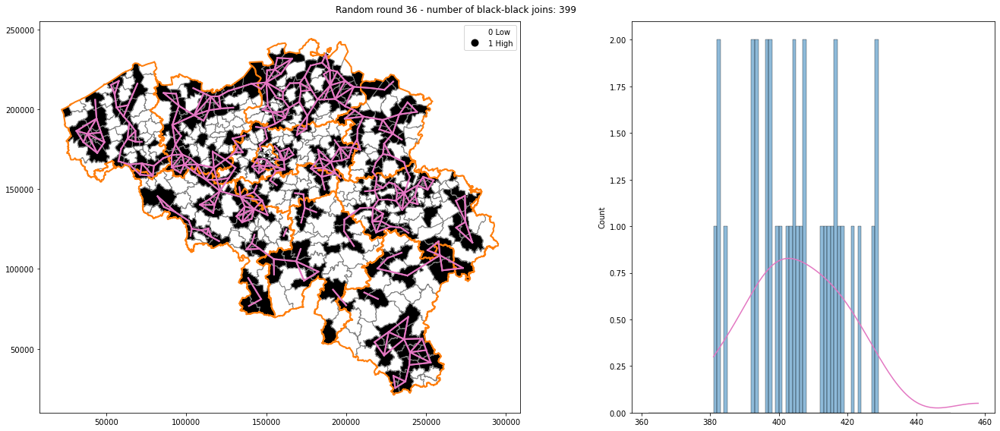

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 23 disconnected components.
 There are 7 islands with ids: 4, 13, 46, 70, 153, 252, 270.
  warnings.warn(m

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


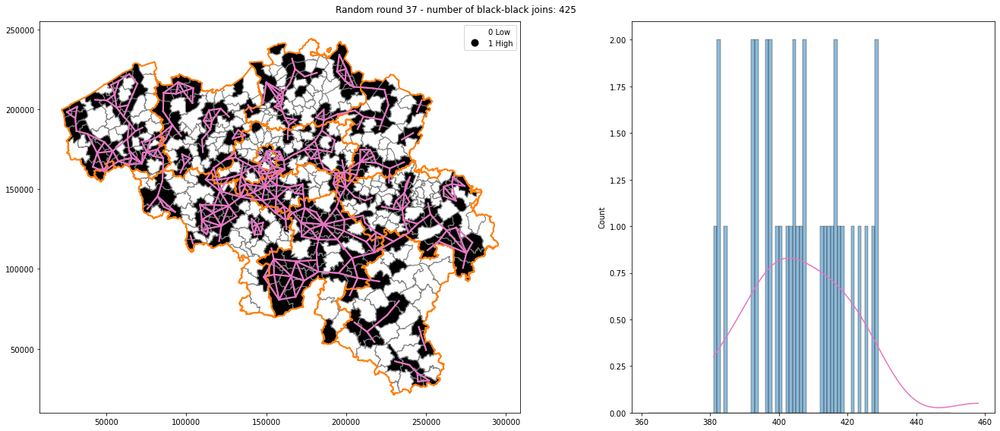

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 21 disconnected components.
 There are 11 islands with ids: 22, 30, 84, 99, 167, 170, 207, 214, 251, 255, 

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

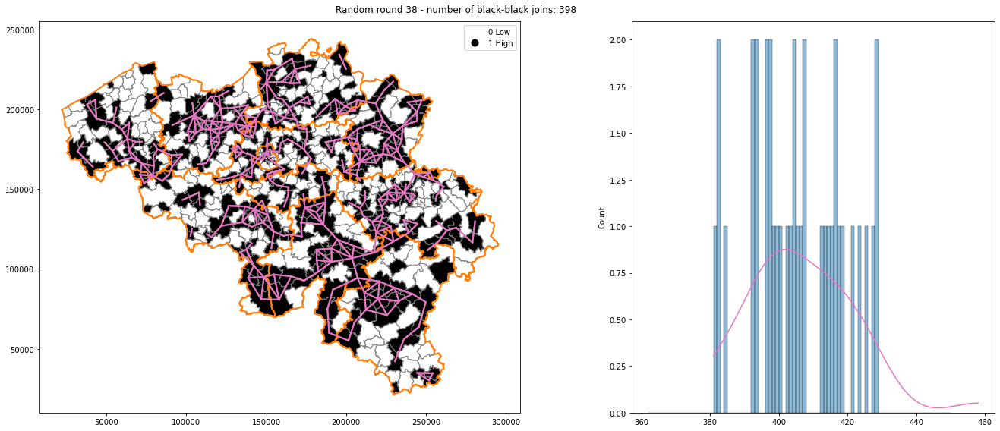

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 20 disconnected components.
 There are 11 islands with ids: 25, 34, 37, 39, 83, 86, 177, 198, 202, 236, 268.
  warnings.warn(message)
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysa

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

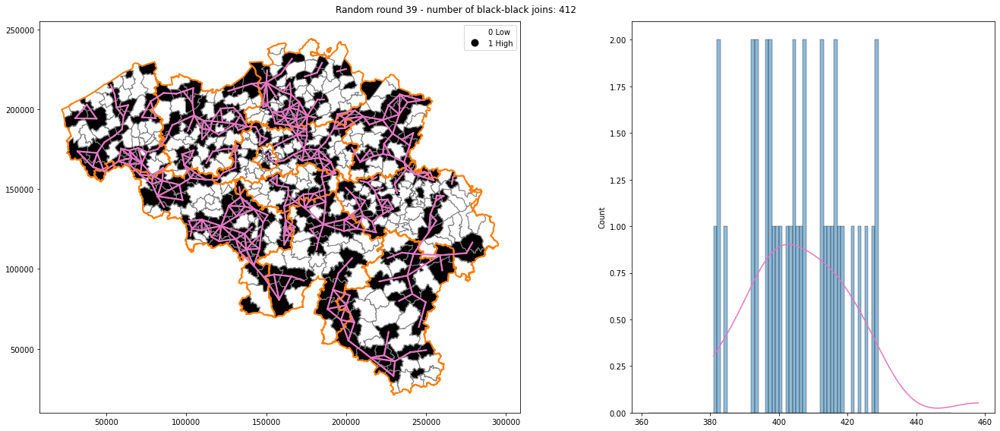

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 33 disconnected components.
 There are 16 islands with ids: 5, 30, 32, 40, 56, 82, 91, 94, 116, 130, 133, 

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


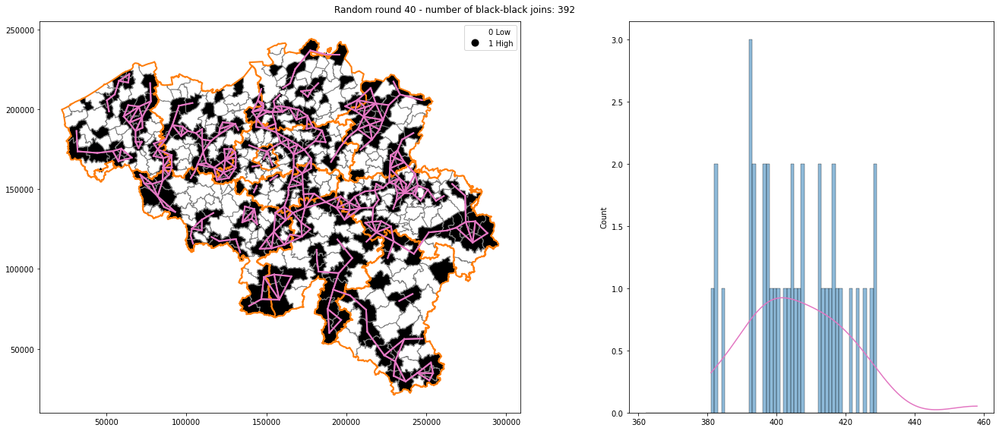

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 26 disconnected components.
 There are 9 islands with ids: 47, 66, 105, 106, 107, 135, 140, 180, 184.
  wa

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


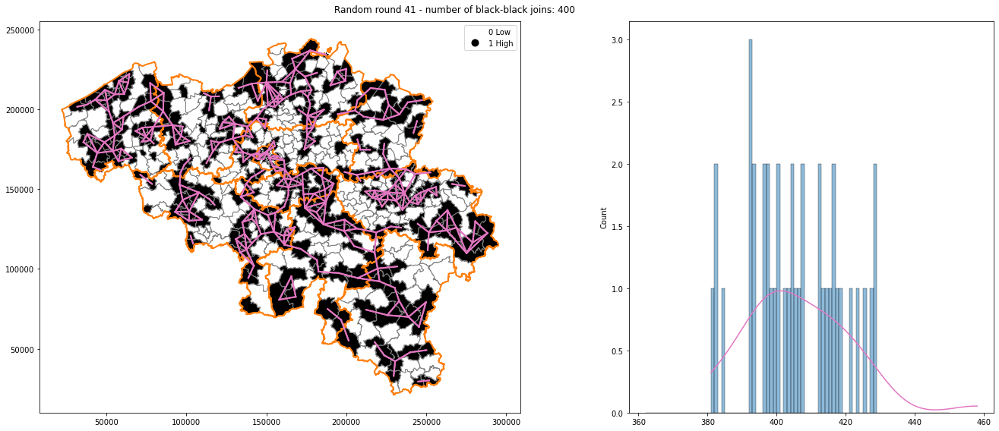

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 21 disconnected components.
 There are 6 islands with ids: 20, 65, 126, 172, 194, 249.
  warnings.warn(mes

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


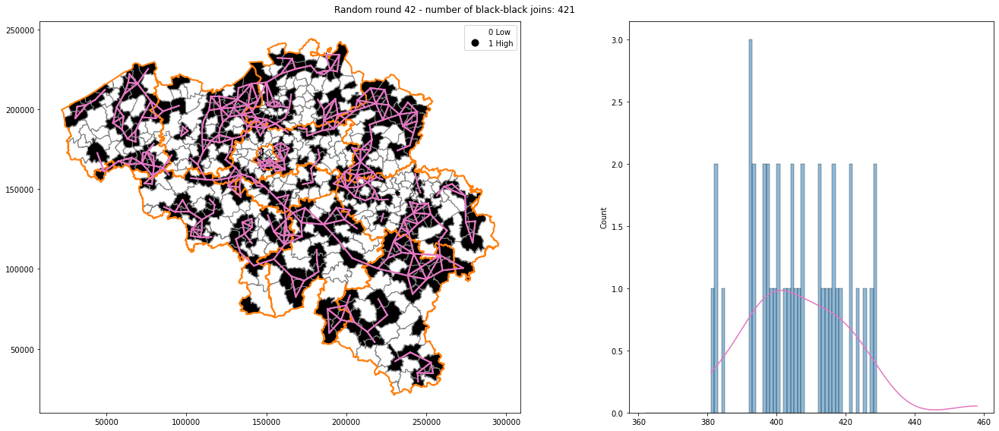

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 33 disconnected components.
 There are 21 islands with ids: 5, 7, 18, 23, 25, 26, 68, 91, 92, 93, 94, 103,

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

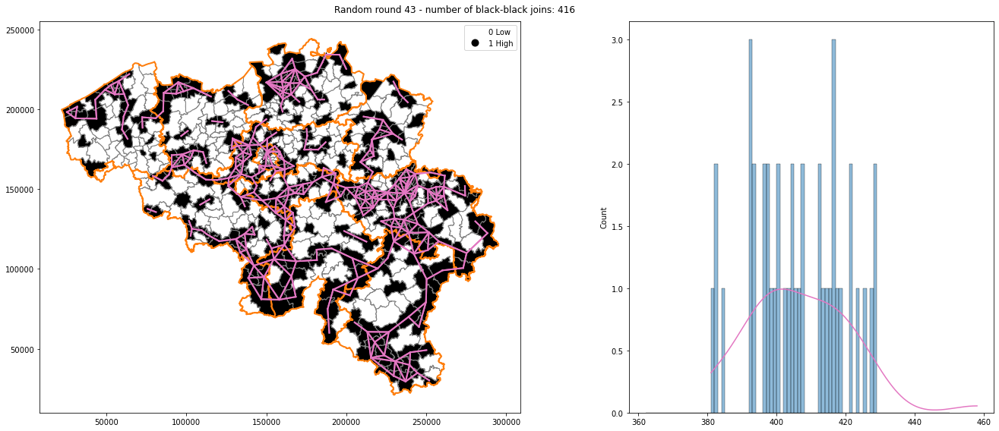

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 24 disconnected components.
 There are 12 islands with ids: 24, 69, 96, 172, 175, 179, 180, 201, 208, 210,

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

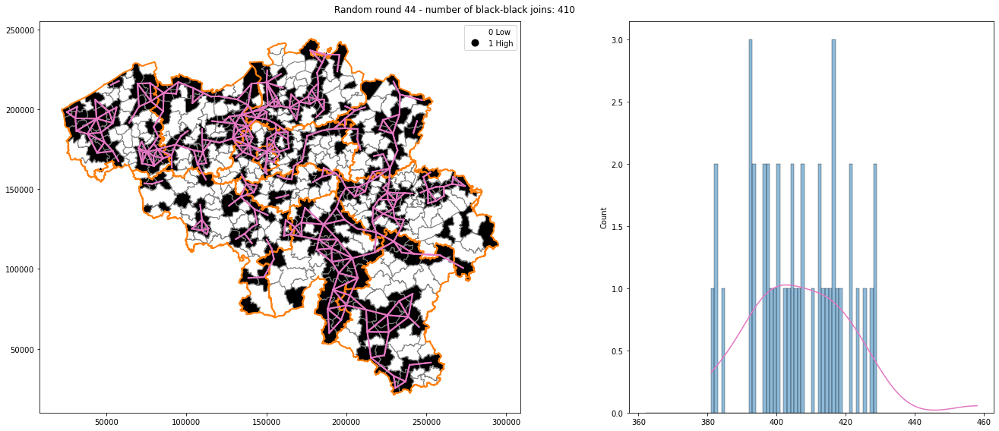

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 19 disconnected components.
 There are 8 islands with ids: 3, 30, 34, 50, 88, 120, 127, 256.
  warnings.wa

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


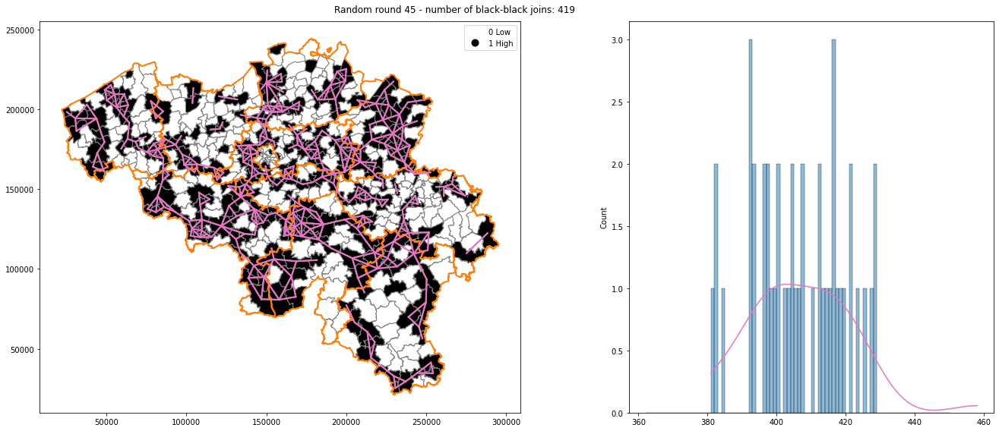

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 32 disconnected components.
 There are 9 islands with ids: 4, 34, 67, 70, 71, 95, 168, 198, 217.
  warning

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:307: UserWarning: {} islands in this weights matrix. Conversion to an adjacency list will drop these observations!
  warnings.warn(
/tmp/ipykernel_24236/2680187769.py:14: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  bb_counts = bb_counts.append(pd.Series([n]))


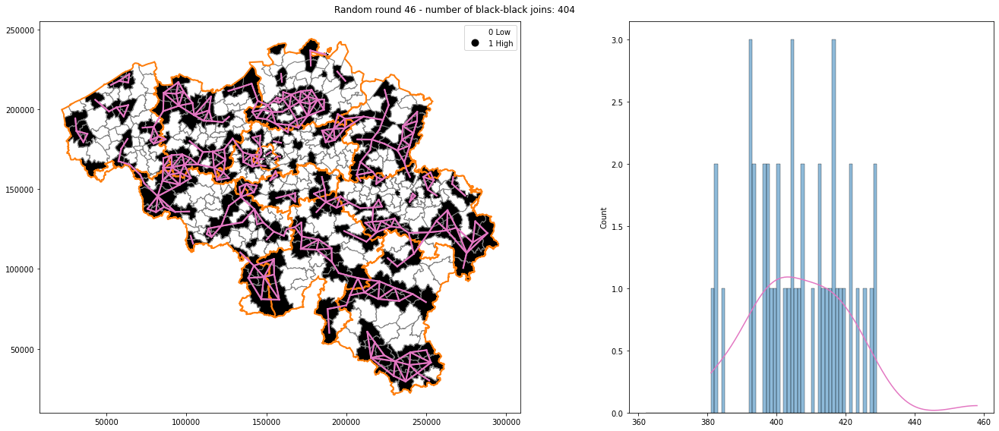

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 20 disconnected components.
 There are 9 islands with ids: 12, 44, 129, 180, 194, 196, 206, 216, 230.
  warnings.warn(message)
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weig

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

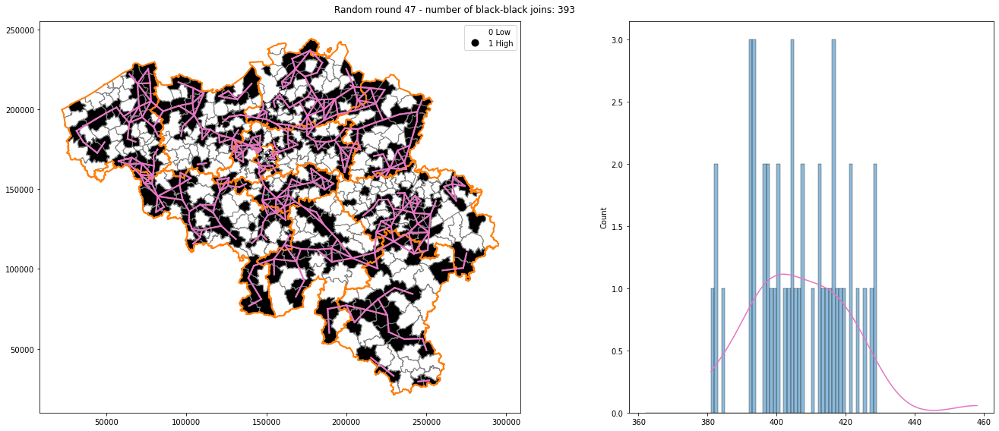

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:31: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(_get_boundary_points(part.boundary) for part in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/_contW_lists.py:29: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return list(it.chain(*(list(zip(*shape.coords.xy)) for shape in shape)))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 21 disconnected components.
 There are 11 islands with ids: 9, 10, 14, 23, 44, 58, 107, 135, 159, 176, 241

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future version. Use a list instead.
  centroids = gdf.loc[neighbors].centroid.apply(lambda p: (p.x, p.y))
/home/vb/anaconda3/envs/gis/lib/python3.8/site-packages/libpysal/weights/weights.py:1294: FutureWarning: Passing a dict as an indexer is deprecated and will raise in a future ver

KeyboardInterrupt: 

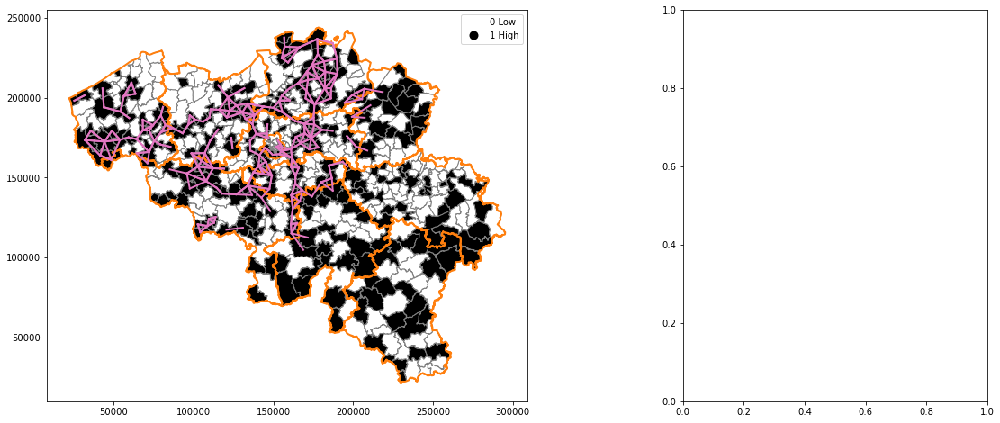

In [53]:
bb_counts = pd.Series(dtype=int)
for i in range(100):
    v="random_n"
    data[v] = np.random.randint(1, 1000, data.shape[0])/1000
    yb[v] = data[v] > data[v].median() 
    data[v+'_yb'] = [labels[i] for i in 1*yb[v]] 
#yb

    f, axes = plt.subplots(1, 2, figsize=(20, 8), gridspec_kw={'width_ratios': [2, 1]})
    
    n = plot_bb(data, "random_n", ax=axes[0])
    
    f.suptitle(f"Random round {i+1} - number of black-black joins: {n:.0f}")
    bb_counts = bb_counts.append(pd.Series([n]))

    sbn.histplot(bb_counts, kde=True, bins=range(int(jc["random1"].min_bb), int(jc["random1"].max_bb)+2), ax=axes[1])
    if len(axes[1].lines)>0 :
        axes[1].lines[0].set_color('C6')
    plt.tight_layout(pad=1)
    plt.savefig(f'{outputpath}/joincuts/join_cuts{i:02d}.png', dpi=100) #,  bbox_inches='tight')
    plt.show()

In [54]:
# Make a video from PNG images - Assumes ffmpeg is installed on the machine
print(f"Making {outputpath}/joincuts.mp4")
os.system(f"rm {outputpath}/joincuts.mp4")
os.system(f"cat {outputpath}/joincuts/join_cuts*.png | ffmpeg -f image2pipe -framerate 2 -i - -c:v libx264 -vf format=yuv420p -r 25 {outputpath}/joincuts.mp4")

Making output/autocorrel/joincuts.mp4


rm: cannot remove 'output/autocorrel/joincuts.mp4': No such file or directory
ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --e

0

We plot here the distribution of the number of black-black joins counts for random runs for the same geography (blue bell), 
as well as the the number of black-black joins for each of the metrics (red vertical lines)



mean_income: 646.0
median_income: 619.0
with_degree: 601.0
area: 580.0
car_per_hh: 470.0


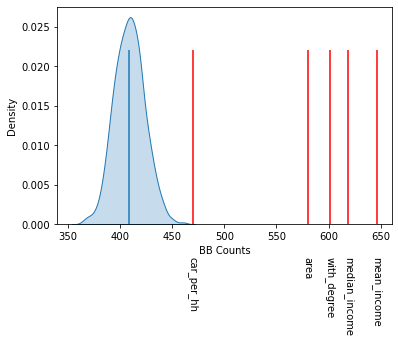

In [55]:
ax = sbn.kdeplot(np.array(jc[data_columns[1]].sim_bb, dtype = float), shade=True)
ylim =  ax.get_ylim()[1]*0.8
trans = transforms.blended_transform_factory(ax.transData, ax.transAxes)
# sbn.displot(jc.sim_bb)
plt.vlines(jc[data_columns[1]].mean_bb, 0,ylim)

plt.xlabel('BB Counts')
for v in ["mean_income", "median_income", "with_degree", "area", "car_per_hh"]: #data_columns :
    plt.vlines(jc[v].bb, 0, ylim, color='r')
    plt.text(jc[v].bb, -.15, v, rotation=-90, va="top", ha="center", transform=trans)
    
    print(f"{v}: {jc[v].bb}")

plt.savefig(f'{outputpath}/join_cuts.png', dpi=150,  bbox_inches='tight')

## Continuous case

In [56]:
wq.transform = 'r'

In [57]:
np.random.seed(12345)
mi = {v: esda.moran.Moran(data[v], wq) for v in data_columns}
{mi[v].I for v in data_columns}

{-0.058802253336900825,
 0.025791860347562465,
 0.10919314629742365,
 0.454426170634088,
 0.46878207251996845,
 0.6048241068575431,
 0.6123133157665215,
 0.6224732496816386,
 0.6247367889465636}

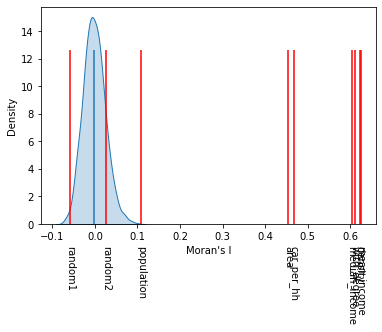

In [58]:
ax = sbn.kdeplot(mi[data_columns[1]].sim, shade=True)
trans = transforms.blended_transform_factory(ax.transData, ax.transAxes)

plt.vlines(mi[data_columns[0]].EI, 0, 0.8 , transform=trans)

plt.xlabel("Moran's I")
for v in data_columns:
     plt.vlines(mi[v].I, 0, 0.8,  color='r', transform=trans)
     plt.text(mi[v].I, -0.1, v, rotation = -90, va = "top", ha = "center", transform=trans)



# Local autocorrelation

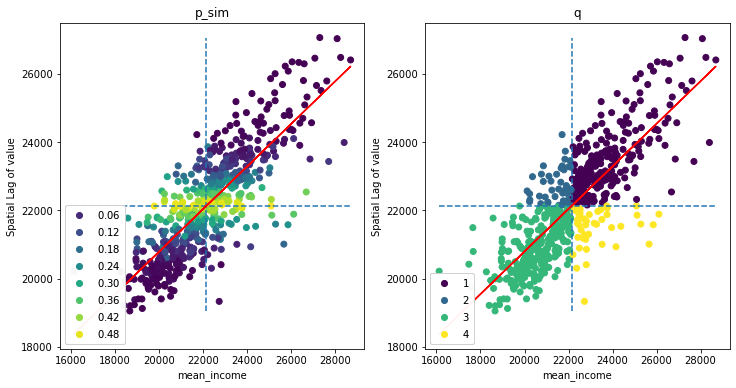

In [59]:
v="mean_income"
# v="density"
b, a = np.polyfit(data[v], ylag[v], 1)
f, axes = plt.subplots(1, 2, figsize=(12, 6))

li = esda.moran.Moran_Local(data[v], wq)
scatters=[None]*2

scatters[0] =axes[0].scatter(data[v], ylag[v], c=li.p_sim)
axes[0].set_title("p_sim")

scatters[1] =axes[1].scatter(data[v], ylag[v], c=li.q)
axes[1].set_title("q")

for i in range(2):
    lgd = axes[i].legend(*scatters[i].legend_elements(),
                    loc="lower left")
    axes[i].add_artist(lgd)

for ax in axes.flatten():
 # dashed vert at mean of the value
    ax.vlines(np.mean(data[v]), ylag[v].min(), ylag[v].max(), linestyle='--')
     # dashed horizontal at mean of lagged value 
    ax.hlines(np.mean(ylag[v]), data[v].min(), data[v].max(), linestyle='--')

    # red line of best fit using global I as slope
    ax.plot(data[v], a + b*data[v], 'r')
    
    ax.set_ylabel('Spatial Lag of value')
    ax.set_xlabel(v)
plt.show()


In [60]:
type(ax)

matplotlib.axes._subplots.AxesSubplot

Text(0, 0.5, 'lag')

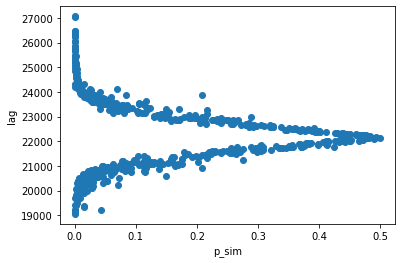

In [61]:
ax=plt.scatter(x=li.p_sim, y=ylag[v])
plt.xlabel("p_sim")
plt.ylabel("lag")

In [62]:
sig = 1 * (li.p_sim < 0.07)
hotspot  = 1 * (sig * li.q==1)
coldspot = 3 * (sig * li.q==3)
doughnut = 2 * (sig * li.q==2)
diamond  = 4 * (sig * li.q==4)
spots = hotspot + coldspot + doughnut + diamond


In [63]:
spot_labels = [ '0 ns', '1 hot spot', '2 doughnut', '3 cold spot', '4 diamond']
labels = [spot_labels[i] for i in spots]


In [64]:
# ax.legend_elements()

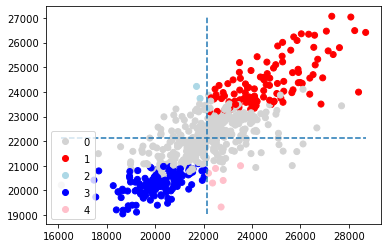

In [65]:
color = (li.p_sim < 0.07) * li.q

hmap = colors.ListedColormap([ 'lightgrey', 'red', 'lightblue', 'blue', 'pink'])

ax=plt.scatter(data[v], ylag[v], c=color, cmap=hmap, label=labels)

plt.legend(*ax.legend_elements(), loc="lower left")

plt.vlines(np.mean(data[v]), ylag[v].min(), ylag[v].max(), linestyle='--')
# dashed horizontal at mean of lagged value 
plt.hlines(np.mean(ylag[v]), data[v].min(), data[v].max(), linestyle='--')

# plt.legend(loc="lower left")
plt.show()

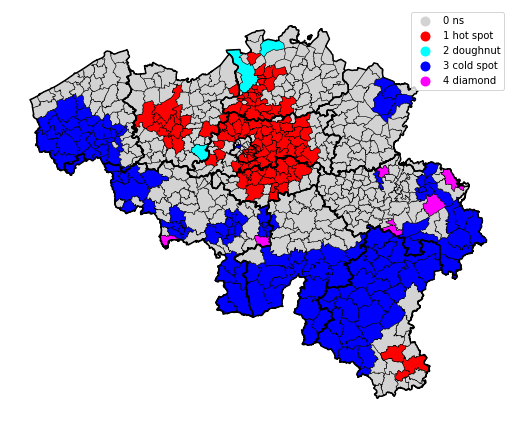

In [68]:
hmap = colors.ListedColormap([ 'lightgrey', 'red', 'lightblue', 'blue', 'pink'])
hmap = colors.ListedColormap([ 'lightgrey', 'red', 'cyan', 'blue', 'fuchsia'])
f, ax = plt.subplots(1, figsize=(9, 9))
data.assign(cl=labels).plot(column='cl', categorical=True, \
        k=2, cmap=hmap, linewidth=0.5, ax=ax, \
        edgecolor='k', legend=True)
extra_bounds.boundary.plot(ax=ax, color='k')
ax.set_axis_off()
plt.show()